# **Practical Assignment 2: Real-time Object Detection System Development and Solution Study**

# 1.	Requirement
This is a capstone assignment, in which you will learn practical object detection technology and solution. The assignment will guide you to develop a real-time object detection system with updated YOLO framework, and you will engage in end-to-end practice, encompassing the entire pipeline from image labelling, model finetuning to webcam deployment. In details, the assignment is comprised of three parts:
* Finetune a basic YOLO model for wall crack detection.
* Retrain the model for live video detection, object tracking and counting.  
* Explore the solutions for diverse object detection applications.

Referring to '**practical_assignment_2.docx**' for the detailed instructions, write down experiment steps, results, answers and literature study into '**practical_assignment_2.docx**', and expand it into your final assignment report.

# 2.	Finetune a YOLOv8 model for crack detection
## 1)	Set up development environment


In [ ]:
# Install ultralytics YOLOv8 packages and dependencies, and check software and hardware
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Setup complete  (4 CPUs, 16.0 GB RAM, 176.3/223.0 GB disk)


In [ ]:
# test in CLI
!yolo predict model=yolov8n.pt source='https://ultralytics.com/images/bus.jpg'

Ultralytics 8.3.40 ðŸš€ Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
YOLOv8n summary (fused): 168 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

image 1/1 C:\Users\Pauline\CVPA2\bus.jpg: 640x480 4 persons, 1 bus, 1 stop sign, 121.7ms
Speed: 7.0ms preprocess, 121.7ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)
Results saved to runs\detect\predict
ðŸ’¡ Learn more at https://docs.ultralytics.com/modes/predict



  0%|          | 0.00/6.25M [00:00<?, ?B/s]
 30%|###       | 1.88M/6.25M [00:00<00:00, 19.5MB/s]
100%|##########| 6.25M/6.25M [00:00<00:00, 37.5MB/s]

  0%|          | 0.00/134k [00:00<?, ?B/s]
100%|##########| 134k/134k [00:00<00:00, 8.11MB/s]


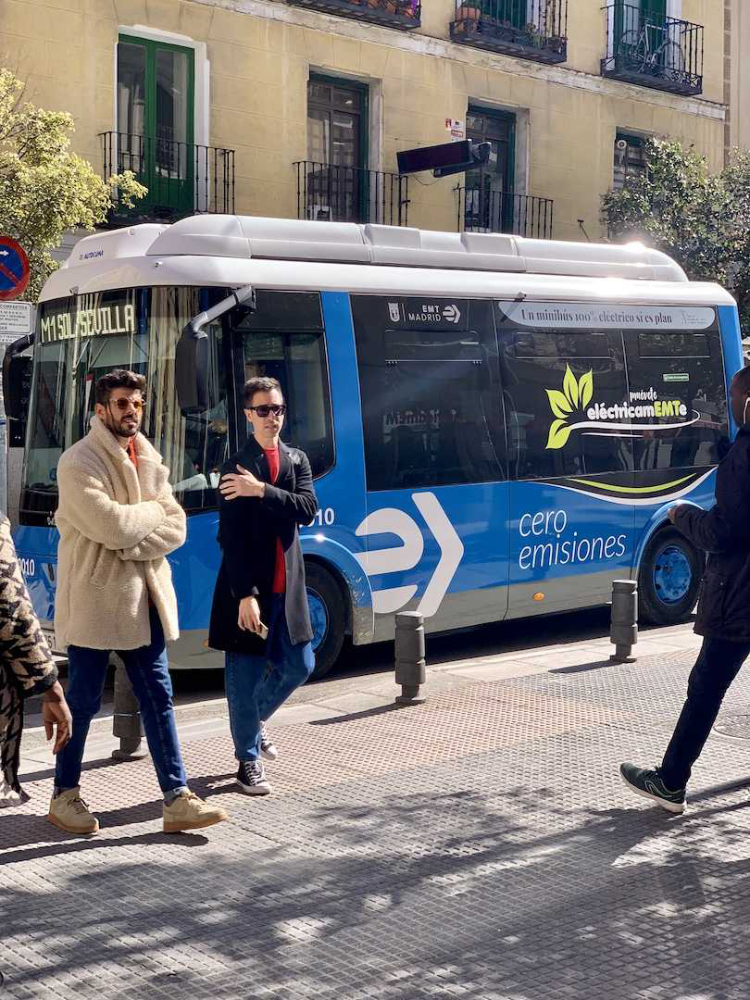

In [ ]:
from IPython.display import display
from PIL import Image

# Load and display the image inline
image_path = "bus.jpg"
image = Image.open(image_path)
display(image)


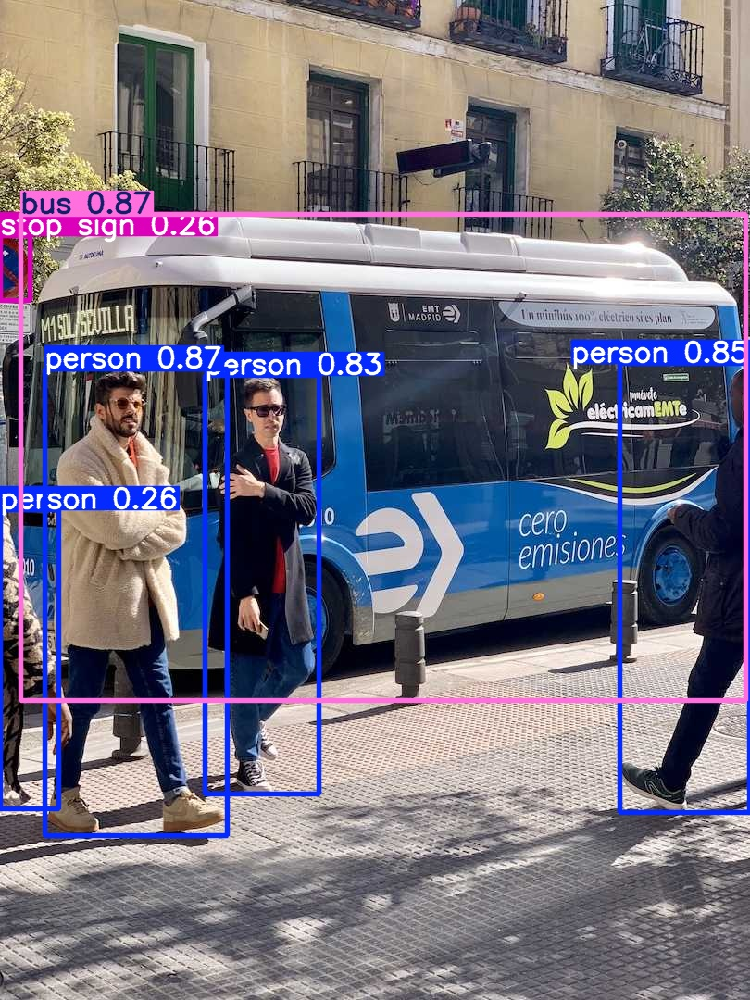

In [ ]:
from IPython.display import Image, display

# Path to the result image
result_image_path = "runs/detect/predict/bus.jpg"

# Display the image
display(Image(filename=result_image_path))


In [ ]:
# change the path based on working environment on your computer
path_PA2 = "C:\\Users\\Pauline\\CVPA2"
path_ymal = path_PA2 + "datasets\\crack400.yaml"
saved_model = path_PA2 + "best.pt"
Test_Image = path_PA2 + "datasets\\crack400\\images\\test\\"

## 2)	Prepare cracks dataset



*   Verify that the number of images in the subfolders under 'raw' are as expected.


Expected result:
-	raw/train: 200 images with cracks
-	raw/val: 100 images with cracks (for validation)
-	raw/test: 50 images with cracks
-	raw/train_background: 25 images without cracks
-	raw/val_background: 15 images without cracks
-	raw/test_background: 10 images without cracks




- Print the image size of all images in train, val, test, train_background, val_background and test_background folders

In [ ]:
import os
from PIL import Image

# Paths to folders
base_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\raw"
folders = ["train", "val", "test", "train_background", "val_background", "test_background"]

# Function to count files in each folder
def count_images_in_folder(folder_path):
    return len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])

# Function to get image dimensions
def get_image_size(image_path):
    with Image.open(image_path) as img:
        return img.size  # Returns (width, height)

# Count and display the number of images in each folder and their sizes
for folder in folders:
    folder_path = os.path.join(base_path, folder)
    num_images = count_images_in_folder(folder_path)
    print(f"{folder}: {num_images} images")

    # Print image paths and dimensions
    for image_name in os.listdir(folder_path):
        image_path = os.path.join(folder_path, image_name)
        if os.path.isfile(image_path):  # Ensure it's a file
            try:
                width, height = get_image_size(image_path)
                print(f"Image: {image_name}, Size: {height}x{width}")
            except Exception as e:
                print(f"Error reading image {image_name}: {e}")


train: 200 images
Image: 1247.jpg, Size: 256x256
Image: 1258.jpg, Size: 256x256
Image: 1323.jpg, Size: 256x256
Image: 1328.jpg, Size: 256x256
Image: 1331.jpg, Size: 256x256
Image: 1340.jpg, Size: 256x256
Image: 1342.jpg, Size: 256x256
Image: 1346.jpg, Size: 256x256
Image: 1352.jpg, Size: 256x256
Image: 1364.jpg, Size: 256x256
Image: 1389.jpg, Size: 256x256
Image: 1390.jpg, Size: 256x256
Image: 1402.jpg, Size: 256x256
Image: 1408.jpg, Size: 256x256
Image: 1412.jpg, Size: 256x256
Image: 1413.jpg, Size: 256x256
Image: 1428.jpg, Size: 256x256
Image: 1438.jpg, Size: 256x256
Image: 1445.jpg, Size: 256x256
Image: 1539.jpg, Size: 256x256
Image: 1552.jpg, Size: 256x256
Image: 1556.jpg, Size: 256x256
Image: 1566.jpg, Size: 256x256
Image: 1567.jpg, Size: 256x256
Image: 1570.jpg, Size: 256x256
Image: 1615.jpg, Size: 256x256
Image: 1623.jpg, Size: 256x256
Image: 1630.jpg, Size: 256x256
Image: 1672.jpg, Size: 256x256
Image: 1674.jpg, Size: 256x256
Image: 1686.jpg, Size: 256x256
Image: 1693.jpg, Size

## 3)	Label images





## 4)	Create dataset config file
- Check the current text in yaml file

In [ ]:
# Path to the YAML file
yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400.yaml"

# Open and read the file
with open(yaml_path, 'r') as file:
    content = file.read()

# Print the full content
print("Full Content of crack400.yaml:")
print(content)

Full Content of crack400.yaml:
# parent folder
# â”œâ”€â”€ PA2
# â””â”€â”€ datasets
#     â””â”€â”€ crack400 

path:   ../datasets/crack400    # dataset root dir
train:  images/train            # train images (relative to 'path')  
val:    images/val              # val images (relative to 'path')  
test:   images/test             # test images (optional, relative to 'path') 

# Classes
names:
  0: crack




In [ ]:
import yaml

# Original YAML file path
original_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400.yaml"

# New YAML file path
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Open and read the original YAML file
with open(original_yaml_path, 'r') as file:
    data = yaml.safe_load(file)

# Update the 'path' field with the absolute path
data['path'] = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400"

# Save the updated content to a new YAML file
with open(new_yaml_path, 'w') as file:
    yaml.safe_dump(data, file)

print(f"Updated YAML file saved successfully as: {new_yaml_path}")


Updated YAML file saved successfully as: C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml


In [ ]:
# Verify the new YAML file
with open(new_yaml_path, 'r') as file:
    content = file.read()

print("Updated YAML Content:")
print(content)


Updated YAML Content:
names:
  0: crack
path: C:\Users\Pauline\CVPA2\datasets\crack400
test: images/test
train: images/train
val: images/val



In [ ]:
import os
if os.path.exists(new_yaml_path):
    print(f"Path is valid: {new_yaml_path}")
else:
    print(f"Path is invalid: {new_yaml_path}")


Path is valid: C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml


## 5) Train model
- Code has been revised to include script to save model and results in local drive.

In [ ]:
import os
from ultralytics import YOLO

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Set environment variable
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Train the model on the dataset for 5 epochs
results = model1.train(data=new_yaml_path, epochs=5, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")



Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=5, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False

100%|██████████| 755k/755k [00:00<00:00, 21.0MB/s]

Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

Model summary: 225 layers, 3,011,043 parameters, 3,011,027 gradients, 8.2 GFLOPs

Transferred 319/355 items from pretrained weights
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<00:00, 298.41it/s]

train: New cache created: C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache



val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<00:00, 294.90it/s]

val: New cache created: C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train2
Starting training for 5 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/5         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:55<00:00,  2.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.57s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/5         0G      1.452      2.271      1.671         20        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105      0.276      0.133      0.183     0.0669



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/5         0G      1.448      2.233      1.649         18        640: 100%|██████████| 25/25 [01:00<00:00,  2.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.63s/it]

                   all        115        105      0.355      0.293       0.24      0.069



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/5         0G      1.436      2.151      1.615         17        640: 100%|██████████| 25/25 [00:58<00:00,  2.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.476      0.305      0.337      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/5         0G      1.487      2.135      1.684         15        640: 100%|██████████| 25/25 [00:56<00:00,  2.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.531      0.629      0.552      0.262



5 epochs completed in 0.098 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train2\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train2\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\train_results\train2\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.30s/it]


                   all        115        105      0.529      0.629       0.55      0.262
Speed: 1.7ms preprocess, 75.8ms inference, 0.0ms loss, 6.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train2
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
import os

# Path to the best.pt file
model_path = "C:\\Users\\Pauline\\CVPA2\\train_results\\train2\\weights\\best.pt"

# Get the file size in MB
file_size = os.path.getsize(model_path) / (1024 * 1024)
print(f"Model file size: {file_size:.2f} MB")


Model file size: 5.95 MB


In [ ]:
from ultralytics import YOLO

# Load the pretrained YOLOv8n model
model = YOLO('yolov8n.pt')

# Print the number of classes (nc)
print(f"Number of classes in pretrained YOLOv8n.pt: {model.model.nc}")


Number of classes in pretrained YOLOv8n.pt: 80


In [ ]:
from ultralytics import YOLO

# Load your fine-tuned model
model = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train2\\weights\\best.pt')

# Print the number of classes (nc)
print(f"Number of classes in your fine-tuned best.pt: {model.model.nc}")


Number of classes in your fine-tuned best.pt: 1


- Code below has been revised to include script to save the test results in local drive.

In [ ]:
import os
from ultralytics import YOLO

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Load the YOLO model
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train2\\weights\\best.pt')

# Evaluate the model's performance on the test set
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")


Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.41s/it]


                   all         60         51      0.654      0.608      0.738      0.344
Speed: 1.9ms preprocess, 79.0ms inference, 0.0ms loss, 6.9ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


### **[Task 1]** Study the dataset and output information, answer the questions below, and write into your report. <br>

 * How many images have you labelled for training, validation and test respectively?
 * What is original image size (H x W)?
 * What is input image size (H x W) required by the YOLOv8 network?
 * What is your model (best.pt) file size?
 * What is your model optimizer and learning rate (lr)?
 * How many layers and parameters does your model have?
 * What is number of classes (nc) in pretrained yolov8n.pt model? And what is number of classes (nc) in your best.pt model?
 * What is your model (best.pt) mAP50 and mAP50-95 on validation set?
 * What is your model (best.pt) mAP50 and mAP50-95 on test set?
 * Among accuracy, recall and precision, which metric is more important for the building quality assurance?


## 6)	Finetune the model

In [ ]:
# Following the Task 2 in the below, retrain and evaluate the model
# Referring to https://docs.ultralytics.com/modes/train/#usage-examples, adjust training arguments (hyperparameters)

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=10, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fals

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train3\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train3
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.693      3.355      1.987          7        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105     0.0029      0.952      0.256     0.0926



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G       1.61      2.932      1.901          8        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.57s/it]

                   all        115        105      0.435        0.4      0.391      0.162



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.621      2.994      1.962          8        640: 100%|██████████| 25/25 [00:55<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.50s/it]

                   all        115        105      0.455       0.47      0.417      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      1.631       2.86      2.027          7        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105      0.192      0.305      0.144     0.0476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G      1.741      2.794      2.034          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.105      0.181     0.0788     0.0215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      1.707      2.771      2.036          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.407      0.429      0.344      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.567       2.51      1.911          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.392      0.429      0.349      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G      1.563      2.438      1.857          8        640: 100%|██████████| 25/25 [00:58<00:00,  2.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.499      0.589      0.538      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G      1.454      2.327      1.828          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.559      0.705      0.628      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G      1.428      2.186       1.75          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.59s/it]

                   all        115        105      0.557      0.771      0.618      0.335



10 epochs completed in 0.186 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train3\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train3\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\train_results\train3\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.37s/it]


                   all        115        105      0.535      0.781      0.612      0.332
Speed: 1.8ms preprocess, 81.5ms inference, 0.0ms loss, 5.5ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train3
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train3\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:06<00:00,  1.50s/it]


                   all         60         51      0.687      0.804       0.78      0.387
Speed: 2.5ms preprocess, 82.7ms inference, 0.0ms loss, 5.6ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val3
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Adjust epoch=20

In [ ]:
# Following the Task 2 in the below, retrain and evaluate the model
# Referring to https://docs.ultralytics.com/modes/train/#usage-examples, adjust training arguments (hyperparameters)

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=20, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=20, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fals

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train4\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train4
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:56<00:00,  2.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20         0G      1.452      2.307      1.676         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.188      0.124      0.121     0.0411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20         0G      1.515      2.316      1.715         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.50s/it]

                   all        115        105      0.351      0.229      0.243     0.0995



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20         0G      1.554      2.268      1.719         17        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.60s/it]

                   all        115        105      0.205      0.305      0.188     0.0628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20         0G      1.544      2.257      1.737         15        640: 100%|██████████| 25/25 [00:57<00:00,  2.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105      0.139      0.248       0.11     0.0303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20         0G      1.488      2.134      1.688         16        640: 100%|██████████| 25/25 [00:57<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.153      0.314      0.133     0.0361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20         0G      1.525      2.132      1.725         25        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.222      0.238      0.156     0.0584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20         0G      1.555      2.122      1.758         22        640: 100%|██████████| 25/25 [00:55<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:14<00:00,  1.76s/it]

                   all        115        105      0.394      0.524       0.34      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20         0G      1.485      2.034        1.7         19        640: 100%|██████████| 25/25 [00:59<00:00,  2.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.287      0.571      0.297      0.136



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20         0G      1.431      1.906       1.62         15        640: 100%|██████████| 25/25 [00:59<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.423      0.622      0.476      0.224


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20         0G      1.576      2.382      1.877          8        640: 100%|██████████| 25/25 [00:59<00:00,  2.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.504      0.581      0.575      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20         0G      1.552      2.376      1.903          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105      0.483      0.495       0.47      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20         0G      1.468      2.202      1.841          8        640: 100%|██████████| 25/25 [00:59<00:00,  2.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105      0.536      0.695      0.603      0.247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20         0G      1.377      2.037      1.748          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.753      0.733      0.749      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20         0G      1.354      1.956      1.714          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.655      0.781      0.696      0.366



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20         0G      1.334      1.896      1.717          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.546      0.752      0.608      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20         0G      1.352      1.834       1.67          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105        0.6      0.743      0.683       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20         0G      1.333      1.723      1.714          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.723      0.744      0.771      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20         0G      1.258      1.627      1.593          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.691      0.809      0.757      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20         0G      1.226      1.618      1.583          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.753      0.813      0.787      0.425



20 epochs completed in 0.378 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train4\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train4\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\train_results\train4\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]


                   all        115        105      0.753      0.811      0.787      0.425
Speed: 1.8ms preprocess, 78.9ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train4
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train4\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


                   all         60         51      0.787      0.868      0.906      0.557
Speed: 1.3ms preprocess, 77.8ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val4
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Adjust epoch=30

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=30, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.43 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=30, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train5\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train5
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:56<00:00,  2.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.68s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30         0G      1.474      2.293      1.697         20        640: 100%|██████████| 25/25 [00:58<00:00,  2.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.59s/it]

                   all        115        105      0.172      0.124      0.131     0.0447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30         0G      1.524       2.37      1.728         18        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.61s/it]

                   all        115        105      0.161      0.257      0.107     0.0265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30         0G      1.645      2.439      1.799         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.50s/it]

                   all        115        105        0.2       0.19      0.143     0.0563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30         0G      1.586      2.357      1.831         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.129      0.229     0.0772     0.0247



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30         0G      1.519      2.208      1.688         16        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.193        0.4      0.157     0.0644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30         0G      1.567      2.153      1.777         25        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.215      0.381      0.247      0.104



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30         0G      1.509      2.176      1.742         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.193      0.276      0.147     0.0425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30         0G      1.486      2.131      1.715         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.253      0.486      0.242     0.0815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30         0G      1.417      1.936      1.624         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.327      0.273      0.225     0.0861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30         0G      1.475       1.87      1.657         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.354      0.333       0.28     0.0791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30         0G      1.504      1.902      1.678         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.389      0.543      0.395      0.167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30         0G      1.385      1.781      1.581         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.379      0.623      0.484      0.209



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30         0G      1.355       1.77      1.575         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.491      0.457      0.438      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30         0G      1.368       1.76      1.582         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.428       0.65       0.51      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30         0G      1.415      1.765      1.604         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.517      0.638      0.564      0.282



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30         0G      1.362      1.687      1.554         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.509      0.648      0.522      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30         0G       1.33      1.628      1.539         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105       0.68      0.695      0.711      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30         0G      1.289      1.581      1.483         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.727      0.735      0.732      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30         0G      1.288      1.596      1.535         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.687      0.649      0.691      0.358


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30         0G      1.428      1.895      1.751          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.701      0.714      0.744      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30         0G      1.393      1.802      1.726          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105        0.7      0.688      0.736       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30         0G      1.328      1.736      1.684          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.648      0.686      0.679      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30         0G      1.335      1.659      1.713          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.717      0.772      0.777      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30         0G       1.28      1.512      1.686         11        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105       0.74      0.819      0.793       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30         0G      1.315      1.593      1.707          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.778      0.781      0.783       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30         0G      1.225      1.535      1.584          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.743      0.714      0.787      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30         0G      1.217      1.515      1.556          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.807      0.752      0.822      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30         0G      1.183        1.5      1.601          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.774      0.829      0.831      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30         0G      1.196      1.446      1.545          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.798      0.762      0.816      0.461



30 epochs completed in 0.548 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train5\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train5\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\train_results\train5\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.22s/it]


                   all        115        105      0.814      0.793      0.831       0.46
Speed: 1.6ms preprocess, 76.6ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train5
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train5\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


                   all         60         51      0.924       0.96      0.964      0.589
Speed: 1.8ms preprocess, 76.8ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val5
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Adjust epoch=50

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=50, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.43 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=50, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train6, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train6\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train6
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50         0G      1.481      2.317      1.712         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.105      0.114     0.0725      0.027



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50         0G      1.535      2.355      1.749         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.271      0.267      0.176     0.0536



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50         0G       1.58      2.428      1.771         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.50s/it]

                   all        115        105     0.0759     0.0857     0.0389     0.0119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50         0G      1.635      2.436      1.881         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105     0.0486      0.533     0.0444     0.0135



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50         0G      1.553      2.312      1.755         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.152      0.448      0.162     0.0605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50         0G      1.538      2.218      1.788         25        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.263      0.267      0.219       0.07



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50         0G      1.544      2.178      1.799         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.209      0.476      0.208     0.0764



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50         0G      1.575      2.109      1.775         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.174      0.276      0.132      0.041



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50         0G      1.529      2.019      1.709         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.168      0.267      0.151     0.0471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50         0G      1.527      1.882      1.685         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.315      0.457      0.352      0.158



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50         0G      1.502      1.928      1.689         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.219      0.467      0.234      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50         0G      1.413      1.861      1.628         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.201        0.5       0.21     0.0825



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50         0G      1.414      1.833      1.626         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105       0.37      0.514      0.382      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50         0G      1.378      1.778      1.586         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.387      0.686      0.496      0.225



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50         0G      1.465      1.784      1.653         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.388      0.448      0.373      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50         0G      1.423       1.79      1.602         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.427      0.532      0.481      0.187



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50         0G      1.384      1.731      1.622         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.417      0.743      0.517      0.214



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50         0G      1.343      1.658      1.531         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.348      0.476      0.371      0.152



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50         0G      1.356      1.653      1.601         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.504      0.629      0.558       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50         0G      1.347      1.694      1.568         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.565      0.695      0.662      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50         0G      1.349      1.626      1.563         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.633      0.656       0.66       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50         0G      1.306      1.559      1.538         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.443      0.674       0.45      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50         0G      1.333      1.616      1.539         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.652      0.713      0.681      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50         0G      1.298      1.645      1.499         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.515      0.714      0.555      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50         0G      1.341      1.653      1.505         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.682      0.733      0.748      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50         0G      1.256      1.536      1.513         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.696      0.733      0.721      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50         0G      1.279      1.553      1.522         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.652      0.648      0.652      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50         0G      1.204      1.477      1.471         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105       0.68       0.61      0.673      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50         0G      1.341      1.446      1.507         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.621        0.8      0.732      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50         0G      1.334      1.541      1.533         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.746      0.701      0.757      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50         0G      1.232      1.456      1.478         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.656      0.752      0.743      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50         0G      1.209      1.413      1.471         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.604      0.756      0.665      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50         0G      1.225      1.476      1.519         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.662      0.733      0.736      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50         0G      1.229      1.473        1.5         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.733      0.743      0.746      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50         0G      1.261      1.475      1.499         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.719      0.686       0.74      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50         0G      1.243      1.453      1.488         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.701      0.691      0.763       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50         0G      1.163      1.464      1.471         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.715      0.771      0.791      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50         0G      1.179      1.365      1.435         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.743        0.8       0.77      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50         0G      1.154      1.382      1.408         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.766      0.743       0.79      0.462


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50         0G      1.308      1.597       1.68          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.794       0.79      0.813      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50         0G      1.226       1.35      1.547          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.789      0.785      0.808      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50         0G      1.239      1.439       1.62          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.746      0.829      0.814      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50         0G      1.171       1.26      1.514          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.827      0.724      0.827      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         0G      1.193      1.275        1.6          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.842      0.762      0.819      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50         0G      1.171       1.27      1.518          9        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.824      0.819      0.844      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         0G      1.185      1.293      1.519          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.809      0.805      0.841      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50         0G      1.192      1.265      1.523          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.854      0.819      0.845      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50         0G      1.165       1.24      1.522         11        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.804      0.848      0.854      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50         0G      1.115      1.176      1.479          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.802      0.848      0.862      0.499



50 epochs completed in 0.907 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train6\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train6\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\train_results\train6\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.19s/it]


                   all        115        105      0.811      0.848      0.862      0.499
Speed: 1.5ms preprocess, 75.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train6
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train6\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


                   all         60         51      0.914      0.838       0.96      0.631
Speed: 1.8ms preprocess, 76.2ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val6
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Adjust epoch=100

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.01, lrf=0.01, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.43 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train7, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classe

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train7\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train7
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.481      2.341      1.714         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.217      0.174      0.133     0.0396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.526      2.359      1.708         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.131      0.276     0.0919     0.0248



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.635      2.364      1.824         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105     0.0635      0.343     0.0399     0.0133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.709      2.439      1.897         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.214       0.41      0.182     0.0567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G      1.597       2.25      1.766         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.077      0.366     0.0753     0.0252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.631      2.232      1.829         25        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105       0.06      0.143     0.0195    0.00494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.602      2.271       1.84         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.118      0.276     0.0989     0.0291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.537      2.189      1.773         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105     0.0446        0.4      0.035    0.00899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G       1.46      1.999      1.659         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.319      0.305      0.235     0.0838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.547      1.898      1.715         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.342      0.381      0.281     0.0909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G      1.502      1.906      1.684         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.255      0.505      0.287      0.115



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.407      1.805      1.593         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.245      0.476      0.274      0.121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      1.433      1.814      1.634         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.342      0.371       0.28      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G      1.406      1.791      1.631         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.485      0.505      0.456      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      1.447      1.798      1.647         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.335      0.581      0.393      0.196



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      1.494      1.727       1.63         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.418      0.596      0.433      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      1.393       1.64      1.593         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.505      0.733      0.569      0.258



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G      1.369      1.623      1.516         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.565      0.571      0.544      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G      1.402       1.62      1.609         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.427      0.581      0.449      0.182



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.434      1.707      1.604         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.539       0.61        0.6      0.263



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.389      1.618       1.59         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.466      0.557      0.508      0.232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.353       1.56      1.548         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.529      0.486      0.503       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.394       1.59      1.572         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.491      0.667      0.522       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G      1.353      1.602      1.529         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.556      0.686      0.626       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G      1.428      1.638      1.549         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.587      0.743      0.609      0.262



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.337      1.572      1.538         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.562      0.743      0.607      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G      1.338      1.581      1.553         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.647      0.676      0.682      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G      1.305      1.505      1.562         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.576      0.724      0.672      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G      1.408       1.48      1.558         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.545      0.537      0.451        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G      1.388      1.582       1.58         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.595      0.714       0.68       0.34



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.304      1.501      1.529         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.692      0.714      0.676      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G      1.267      1.451      1.488         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.566      0.705      0.669      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G       1.25      1.503      1.518         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.708      0.752      0.706      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G      1.306      1.527      1.517         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.521      0.705      0.572      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.355      1.521      1.528         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.698      0.829      0.727      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G      1.285      1.492      1.483         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.696      0.781      0.732      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G       1.23      1.488       1.52         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.608      0.591      0.579       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G      1.301       1.48      1.511         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.686       0.79      0.746      0.402



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G      1.297      1.489      1.513         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.809      0.805      0.813      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G      1.255      1.396      1.476         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.716      0.793      0.751      0.363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G      1.254      1.436      1.489         12        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105       0.66      0.771      0.711      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G      1.303      1.395      1.485         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.717      0.714       0.72      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G       1.26       1.41      1.456         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.678      0.771      0.776      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G      1.198       1.31      1.443         12        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105       0.64      0.694      0.717      0.385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G      1.301       1.42      1.487         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.591      0.785      0.689      0.352



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G      1.239      1.349      1.449         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.786      0.781      0.805      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G      1.275      1.438       1.47         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.692      0.792      0.781      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G      1.203       1.31      1.437         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.674      0.829      0.747      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G      1.265      1.354      1.472         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.698      0.771      0.771      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      1.215      1.337      1.462         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.662      0.838      0.765      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G      1.281      1.293      1.502         25        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.721      0.781      0.742      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G       1.18      1.293      1.431         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.807      0.743      0.791      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G      1.195      1.311      1.401         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.776       0.79      0.823      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G      1.245      1.291      1.451         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.801      0.767      0.819      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G      1.113      1.276      1.378         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.731      0.771      0.784      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G      1.198      1.347      1.418         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105       0.74       0.81      0.789      0.428



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G      1.126      1.284      1.388         23        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.789      0.819      0.808      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G      1.194      1.299      1.414         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.786       0.79      0.812      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G      1.143      1.227      1.395         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.771      0.819      0.854      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G      1.248      1.312      1.498         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.734      0.743      0.738      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G      1.203      1.263       1.41         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.847      0.789      0.784      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G       1.18      1.261      1.442         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.766       0.81      0.806       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G      1.151        1.2      1.373         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.836      0.857      0.824      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G      1.166      1.246      1.388         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105       0.73      0.867      0.764      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G      1.072      1.264      1.348         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.772      0.776      0.773       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G      1.087      1.258      1.377         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.664      0.735      0.718      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G      1.079      1.234      1.349         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.759      0.838      0.779      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G      1.142      1.254      1.408         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.821      0.829      0.827       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G      1.124      1.231      1.424         13        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.848      0.798      0.823      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G       1.09      1.187      1.389         25        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.795      0.867      0.837      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G      1.104      1.176      1.376         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.814      0.834       0.85      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G      1.084      1.171      1.344         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.845      0.857      0.856      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G      1.074      1.123       1.34         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.873      0.857      0.859      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G      1.058      1.265      1.355         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.834      0.838      0.853      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G      1.093      1.202      1.375         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.803      0.815      0.847      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G      1.071        1.2      1.367         23        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.826      0.848      0.848      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G      1.105      1.238       1.39         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.864      0.819      0.849      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G      1.111      1.121      1.367         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.798      0.848      0.845      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G      1.099      1.138      1.339         27        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.798      0.864      0.839      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G       1.06      1.155      1.347         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.852      0.867      0.857      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G      1.068      1.081      1.379         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.843      0.857      0.847      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G      1.124       1.13      1.371         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.879      0.867      0.845      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G      1.101      1.208      1.358         20        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.882      0.855      0.845      0.509



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G     0.9904      1.092      1.307         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105        0.8      0.838      0.825      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G      1.074      1.134      1.347         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.851       0.81      0.853      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G      1.021      1.125      1.339         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.847      0.819      0.846      0.519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G      1.083      1.098      1.363         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.869      0.838      0.853      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G      1.028      1.108      1.312         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105       0.87       0.83      0.843       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G      1.113      1.121      1.355         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.888      0.827       0.85      0.518


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G      1.119      1.179      1.495          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.857      0.829      0.846      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G      1.047      1.092      1.402         10        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.848      0.849      0.863      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G      1.019      1.033       1.41          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.866      0.857      0.868      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G      1.095      1.119      1.473          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.846      0.876      0.852      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G      1.083      1.085      1.459          9        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.824      0.867       0.85      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G      1.046      1.069      1.468          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.826      0.867      0.856      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G     0.9529     0.9325      1.354          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.818      0.858      0.858      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G      0.971     0.9869      1.407          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.829      0.848      0.857      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G     0.9731     0.9435      1.332          9        640: 100%|██████████| 25/25 [00:52<00:00,  2.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.849      0.857      0.859      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.9955     0.9553      1.371          8        640: 100%|██████████| 25/25 [00:52<00:00,  2.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.848      0.849       0.86      0.518



100 epochs completed in 1.817 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train7\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train7\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train7\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.20s/it]


                   all        115        105      0.868      0.838      0.853      0.533
Speed: 1.7ms preprocess, 75.6ms inference, 0.0ms loss, 0.2ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train7
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train7\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.26s/it]


                   all         60         51          1      0.978      0.992      0.637
Speed: 1.4ms preprocess, 75.7ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val7
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100 and adjust lr0 = 0.01 and lrf = 0.02

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.01, lrf=0.02, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.43 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train8, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classe

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train8\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train8
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:57<00:00,  2.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.485      2.342      1.719         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.172      0.219      0.119     0.0341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.527      2.378      1.719         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.52s/it]

                   all        115        105      0.239      0.248       0.18     0.0505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.564      2.343       1.74         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.271      0.352      0.221     0.0671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G      1.662      2.371      1.856         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.142      0.105     0.0513     0.0167



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G       1.62      2.178       1.77         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.148        0.2      0.108     0.0385



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.657      2.166       1.83         25        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.187      0.333      0.131      0.039



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.554       2.15      1.783         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105     0.0857      0.171     0.0637     0.0357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.544      2.138      1.778         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.192      0.124       0.08     0.0297



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G      1.527      2.021      1.726         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.27      0.467      0.294      0.122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.521      1.886      1.708         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.387      0.562      0.488      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G      1.487      1.934      1.707         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.236       0.39      0.269      0.113



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.429      1.802      1.607         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.156      0.229      0.152      0.064



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G      1.446      1.819      1.612         13        640: 100%|██████████| 25/25 [00:58<00:00,  2.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105        0.3      0.352      0.258     0.0994



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G      1.451       1.84      1.642         15        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.338      0.543      0.365      0.148



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      1.459       1.83      1.634         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.414      0.581      0.498        0.2



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      1.469      1.778      1.678         21        640: 100%|██████████| 25/25 [00:55<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.536      0.714       0.59       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      1.457      1.733      1.659         18        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.399      0.543      0.388      0.166



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G      1.437      1.709      1.587         18        640: 100%|██████████| 25/25 [00:58<00:00,  2.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.496      0.524      0.498      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G      1.421      1.671      1.646         19        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.546      0.505      0.541      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.352      1.684      1.552         21        640: 100%|██████████| 25/25 [00:55<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.61s/it]

                   all        115        105      0.531      0.629      0.551       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.377      1.598      1.585         22        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.406      0.705      0.477       0.22



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.314      1.603       1.54         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105       0.68      0.695      0.682      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.395      1.616      1.571         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.64s/it]

                   all        115        105      0.609      0.629       0.59      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G      1.352      1.677      1.543         24        640: 100%|██████████| 25/25 [00:58<00:00,  2.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:14<00:00,  1.82s/it]

                   all        115        105      0.529      0.676      0.554       0.25



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G      1.381      1.687      1.541         19        640: 100%|██████████| 25/25 [01:13<00:00,  2.93s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.539      0.613      0.617      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.315       1.54      1.549         21        640: 100%|██████████| 25/25 [01:16<00:00,  3.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.59s/it]

                   all        115        105      0.477      0.648      0.525       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G      1.344      1.586      1.555         21        640: 100%|██████████| 25/25 [00:56<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.404      0.571      0.482      0.219



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G      1.261      1.501      1.495         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.683      0.676      0.692      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G      1.317      1.481      1.529         24        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.615      0.667      0.691      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G      1.358      1.544      1.547         16        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.604      0.667      0.656      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.285      1.506      1.503         17        640: 100%|██████████| 25/25 [01:00<00:00,  2.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.713       0.59      0.691      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G      1.289      1.491      1.484         16        640: 100%|██████████| 25/25 [00:55<00:00,  2.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105       0.57      0.771      0.646      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G      1.275      1.517      1.541         15        640: 100%|██████████| 25/25 [00:56<00:00,  2.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.624      0.711      0.706      0.356



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G      1.291      1.554      1.525         18        640: 100%|██████████| 25/25 [00:58<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.588      0.733      0.648      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.335       1.56      1.529         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.762      0.731      0.787      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G       1.27      1.497      1.476         18        640: 100%|██████████| 25/25 [01:04<00:00,  2.58s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.679      0.695      0.721       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G      1.236      1.502      1.523         20        640: 100%|██████████| 25/25 [00:56<00:00,  2.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105        0.6      0.686      0.658      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G       1.28      1.418      1.527         17        640: 100%|██████████| 25/25 [00:55<00:00,  2.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.705      0.724      0.734      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G      1.282      1.443      1.497         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105        0.7      0.695      0.779      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G      1.277      1.423      1.477         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.697      0.743      0.724      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G      1.298      1.512      1.492         12        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.687      0.732      0.723      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G      1.336      1.459      1.501         19        640: 100%|██████████| 25/25 [00:56<00:00,  2.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.597      0.706      0.672      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G      1.219      1.434      1.442         18        640: 100%|██████████| 25/25 [00:56<00:00,  2.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.676      0.724      0.723      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G      1.203       1.36      1.459         12        640: 100%|██████████| 25/25 [00:57<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105       0.66      0.724      0.734      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G      1.292      1.413      1.478         21        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.64      0.743      0.729      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G      1.254      1.355      1.464         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.599      0.711       0.65      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G      1.215      1.383      1.432         24        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.60s/it]

                   all        115        105      0.607      0.762      0.648      0.342



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G      1.228      1.311       1.46         21        640: 100%|██████████| 25/25 [00:59<00:00,  2.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.758      0.752      0.779       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G      1.236      1.325      1.459         19        640: 100%|██████████| 25/25 [00:58<00:00,  2.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.69s/it]

                   all        115        105      0.787      0.809      0.801      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      1.218      1.321      1.464         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.685      0.786      0.738      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G      1.229      1.304      1.465         25        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.752      0.829       0.79       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G      1.179      1.342       1.45         13        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.739      0.848      0.802      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G      1.176      1.296      1.396         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105       0.74      0.848      0.792      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G      1.235      1.356      1.457         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.735      0.793       0.77      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G      1.107      1.257      1.374         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.771       0.81      0.832      0.444



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G      1.175      1.321      1.405         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.769      0.838      0.799      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G      1.147      1.259      1.388         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105       0.76      0.817      0.797      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G      1.172      1.279      1.392         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.663      0.733      0.723      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G      1.169      1.275      1.432         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.738      0.733      0.762      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G      1.191      1.291      1.469         13        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.748      0.829      0.814      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G      1.163       1.27      1.395         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.717      0.796      0.772      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G      1.153      1.244      1.424         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.735      0.793      0.789      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G      1.151      1.206      1.377         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.804      0.783      0.809       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G       1.14      1.273      1.392         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.783      0.823      0.823       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G      1.115      1.211      1.361         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.788      0.816      0.829      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G      1.098      1.266      1.397         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.783      0.825      0.808      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G      1.117      1.213      1.356         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.723      0.818      0.796      0.467



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G      1.154       1.24      1.431         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.842      0.838      0.828      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G      1.095      1.207      1.406         13        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.773      0.819      0.821      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G      1.099      1.192      1.392         25        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.831      0.819      0.814      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G      1.086      1.189      1.367         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.838      0.848      0.813      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G      1.087      1.153      1.347         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.85      0.848      0.839      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G      1.065      1.119      1.331         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.83      0.837      0.846      0.468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G      1.085      1.261      1.379         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.814      0.848      0.831      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G      1.119      1.185      1.392         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.763      0.848      0.823       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G      1.117      1.247      1.403         23        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.838      0.838      0.829      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G      1.108      1.205      1.382         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105       0.87      0.819      0.847       0.51



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G      1.124      1.163      1.365         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.866      0.829      0.861      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G      1.077      1.135       1.32         27        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.852      0.867      0.854      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G      1.053      1.148      1.353         16        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.864      0.857      0.849      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G      1.083      1.101      1.387         17        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.862      0.848      0.858      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G      1.114      1.153      1.365         22        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.864      0.876      0.864      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G      1.089      1.183      1.353         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.857      0.859       0.86      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G     0.9968      1.098      1.309         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105       0.85      0.857      0.852      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G      1.054      1.149      1.338         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.875      0.869      0.861      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G      1.006      1.132      1.323         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.841      0.829      0.843      0.524



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G      1.086      1.099       1.37         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.827      0.819      0.833      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G      1.049      1.135      1.328         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.833      0.838      0.833      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G      1.093      1.107      1.341         24        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.853      0.831      0.859       0.51


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G      1.108      1.148      1.509          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.837      0.876      0.853      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G      1.052      1.091      1.392         10        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.843      0.872      0.858      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G      1.001      1.048      1.377          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.839      0.867      0.859      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G      1.075        1.1      1.437          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.844      0.879      0.866      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G      1.065      1.029      1.437          9        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.862      0.848      0.869      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G       1.05      1.069      1.454          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.881      0.847      0.874      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G     0.9334     0.9526      1.338          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.875      0.886      0.868      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.9969      1.014      1.415          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.876      0.867      0.871      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G      1.039      0.964      1.388          9        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.843      0.895      0.868      0.543



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.9675     0.9261      1.352          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.843      0.895      0.859       0.53



100 epochs completed in 1.877 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train8\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train8\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train8\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:09<00:00,  1.22s/it]


                   all        115        105      0.844      0.895      0.868      0.542
Speed: 1.6ms preprocess, 77.0ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train8
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train8\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.30s/it]


                   all         60         51      0.985      0.941      0.988      0.647
Speed: 1.8ms preprocess, 77.7ms inference, 0.0ms loss, 0.4ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val8
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100 and adjust lr0 = 0.01 and lrf = 0.03

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.01, lrf=0.03, batch=8, project=destination_dir)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.43 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
engine\trainer: task=detect, mode=train, model=yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train9, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classe

train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]

Plotting labels to C:\Users\Pauline\CVPA2\train_results\train9\labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train9
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      1.511      2.578      1.739         21        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105    0.00278      0.914      0.356      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.484      2.341      1.716         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105        0.2      0.229      0.136     0.0386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100         0G      1.539      2.372      1.743         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.176      0.219      0.122     0.0351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100         0G      1.631      2.407      1.832         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105      0.249      0.286       0.15     0.0517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100         0G       1.69      2.442      1.899         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105     0.0464     0.0476     0.0175    0.00542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G       1.64      2.298       1.82         16        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105     0.0899      0.333     0.0745     0.0244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100         0G      1.617      2.231      1.824         25        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.301      0.343       0.24     0.0789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.593      2.218      1.803         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.151      0.314      0.108     0.0315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100         0G      1.593      2.173      1.761         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.194       0.39      0.206     0.0889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100         0G      1.531      2.017      1.712         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.251      0.324      0.195     0.0715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100         0G      1.557      1.913      1.684         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.383      0.486      0.345      0.129



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100         0G       1.55      1.953        1.7         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.274      0.362      0.241      0.078



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100         0G      1.419      1.823      1.614         16        640: 100%|██████████| 25/25 [00:57<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.358      0.467      0.318     0.0978



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100         0G        1.5      1.823      1.658         13        640: 100%|██████████| 25/25 [01:05<00:00,  2.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.63s/it]

                   all        115        105       0.52      0.476      0.483      0.204



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100         0G      1.461      1.804      1.645         15        640: 100%|██████████| 25/25 [00:57<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.407       0.61      0.418      0.172



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100         0G      1.516      1.866      1.719         16        640: 100%|██████████| 25/25 [01:16<00:00,  3.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.75s/it]

                   all        115        105      0.302      0.457      0.288      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100         0G      1.534      1.796      1.686         21        640: 100%|██████████| 25/25 [01:12<00:00,  2.90s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:18<00:00,  2.33s/it]

                   all        115        105      0.319      0.568       0.34      0.157



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      1.472      1.738      1.674         18        640: 100%|██████████| 25/25 [01:16<00:00,  3.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.69s/it]

                   all        115        105      0.445        0.6      0.479      0.228



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100         0G      1.362      1.722       1.57         18        640: 100%|██████████| 25/25 [01:22<00:00,  3.29s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:20<00:00,  2.52s/it]

                   all        115        105      0.433      0.667       0.51      0.216



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100         0G      1.395      1.713      1.618         19        640: 100%|██████████| 25/25 [01:10<00:00,  2.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105      0.569      0.605      0.581      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.443      1.769      1.615         21        640: 100%|██████████| 25/25 [00:56<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.63s/it]

                   all        115        105      0.503      0.619      0.544      0.241



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.421      1.681      1.608         22        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.425        0.6      0.467      0.184



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100         0G      1.386      1.587      1.579         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.515        0.6      0.516      0.222



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.368       1.65      1.568         19        640: 100%|██████████| 25/25 [01:03<00:00,  2.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.484       0.67      0.496      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100         0G      1.409      1.734      1.546         24        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.499      0.581      0.515      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100         0G      1.419       1.69      1.546         19        640: 100%|██████████| 25/25 [00:53<00:00,  2.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.627      0.705      0.687      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100         0G      1.369      1.592      1.552         21        640: 100%|██████████| 25/25 [00:53<00:00,  2.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.39s/it]

                   all        115        105      0.585      0.495       0.53       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100         0G      1.424      1.649      1.599         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.58s/it]

                   all        115        105      0.663      0.648      0.705      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100         0G      1.303      1.577      1.522         23        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.527      0.581      0.601      0.269



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100         0G      1.414      1.582      1.583         24        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.527      0.571       0.57      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100         0G       1.41      1.601      1.587         16        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.652      0.686      0.707      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100         0G      1.314      1.569      1.532         17        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.46s/it]

                   all        115        105       0.74      0.752      0.771      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100         0G      1.304      1.528       1.51         16        640: 100%|██████████| 25/25 [00:55<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.702      0.743      0.759      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100         0G      1.286      1.587      1.548         15        640: 100%|██████████| 25/25 [01:00<00:00,  2.41s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.685      0.771      0.762      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100         0G      1.318      1.521      1.553         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.759      0.695       0.78      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100         0G      1.342      1.546      1.524         23        640: 100%|██████████| 25/25 [00:58<00:00,  2.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.72s/it]

                   all        115        105      0.685       0.81      0.758      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100         0G      1.318      1.528      1.517         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.728        0.8      0.727      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100         0G      1.242      1.509      1.517         20        640: 100%|██████████| 25/25 [00:58<00:00,  2.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.667      0.667      0.698      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100         0G      1.277      1.471      1.497         17        640: 100%|██████████| 25/25 [01:00<00:00,  2.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.688      0.686      0.733      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G      1.236      1.506      1.466         17        640: 100%|██████████| 25/25 [00:53<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105       0.79      0.676      0.772       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100         0G      1.238      1.412      1.471         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.694      0.724      0.749      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100         0G      1.263      1.453      1.482         12        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105       0.78      0.777      0.788      0.423



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100         0G      1.281      1.406      1.478         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.763      0.771      0.783      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100         0G      1.253      1.489      1.467         18        640: 100%|██████████| 25/25 [00:55<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.799       0.81      0.822      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100         0G      1.213      1.355      1.463         12        640: 100%|██████████| 25/25 [00:56<00:00,  2.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.794      0.769      0.805      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100         0G      1.303      1.433      1.489         21        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105      0.788      0.779       0.82      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100         0G      1.234      1.372      1.441         22        640: 100%|██████████| 25/25 [00:56<00:00,  2.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.799        0.8      0.804      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G       1.26      1.392      1.469         24        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.721      0.712      0.739      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100         0G      1.211      1.303      1.439         21        640: 100%|██████████| 25/25 [00:55<00:00,  2.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.47s/it]

                   all        115        105      0.743      0.798      0.777      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100         0G      1.252      1.387      1.461         19        640: 100%|██████████| 25/25 [00:55<00:00,  2.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.855      0.838       0.84      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100         0G      1.218      1.345       1.47         19        640: 100%|██████████| 25/25 [01:05<00:00,  2.61s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105      0.765      0.807      0.816      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G      1.221      1.322      1.461         25        640: 100%|██████████| 25/25 [00:56<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.669      0.771      0.775      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G      1.166      1.302      1.446         13        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.748      0.829      0.795      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100         0G      1.152      1.299      1.391         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.806      0.829      0.794      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100         0G      1.232      1.353      1.462         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.807      0.781      0.798      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100         0G      1.148      1.248      1.389         17        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.861      0.829      0.832      0.456



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100         0G      1.173      1.321      1.399         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.793       0.79      0.821      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100         0G      1.137       1.25      1.388         23        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.752       0.81       0.81      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100         0G      1.197      1.269      1.411         18        640: 100%|██████████| 25/25 [00:54<00:00,  2.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.837      0.838      0.843      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100         0G      1.191      1.282      1.431         20        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.789      0.762      0.776      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100         0G      1.202      1.303      1.475         13        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.76      0.786      0.772      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100         0G      1.173      1.271      1.397         19        640: 100%|██████████| 25/25 [01:02<00:00,  2.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.787      0.808      0.793      0.453



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100         0G      1.158      1.272      1.431         21        640: 100%|██████████| 25/25 [01:05<00:00,  2.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.53s/it]

                   all        115        105      0.712      0.822      0.766      0.448



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100         0G      1.161      1.252      1.387         21        640: 100%|██████████| 25/25 [01:00<00:00,  2.42s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.50s/it]

                   all        115        105      0.806      0.791      0.797      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100         0G      1.152      1.288      1.406         22        640: 100%|██████████| 25/25 [00:58<00:00,  2.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:17<00:00,  2.17s/it]

                   all        115        105      0.827      0.819      0.818      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100         0G      1.108      1.238      1.368         21        640: 100%|██████████| 25/25 [01:04<00:00,  2.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.839       0.81      0.834      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100         0G      1.069      1.251      1.374         20        640: 100%|██████████| 25/25 [01:04<00:00,  2.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105      0.709       0.79      0.765      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100         0G      1.086      1.219       1.35         18        640: 100%|██████████| 25/25 [01:03<00:00,  2.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.743      0.852      0.774      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100         0G      1.167      1.297      1.427         18        640: 100%|██████████| 25/25 [01:06<00:00,  2.68s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.73s/it]

                   all        115        105      0.772      0.771      0.789      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100         0G      1.106      1.253      1.403         13        640: 100%|██████████| 25/25 [00:58<00:00,  2.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.54s/it]

                   all        115        105      0.803      0.848      0.812      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G      1.098      1.238      1.401         25        640: 100%|██████████| 25/25 [00:57<00:00,  2.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.57s/it]

                   all        115        105      0.775      0.819      0.791      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100         0G      1.084      1.207      1.359         22        640: 100%|██████████| 25/25 [00:56<00:00,  2.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:14<00:00,  1.78s/it]

                   all        115        105      0.799      0.819      0.821      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G      1.091      1.184      1.354         22        640: 100%|██████████| 25/25 [01:02<00:00,  2.48s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.71s/it]

                   all        115        105      0.818      0.772      0.824      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G      1.084      1.133      1.349         19        640: 100%|██████████| 25/25 [01:27<00:00,  3.51s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:14<00:00,  1.78s/it]

                   all        115        105      0.881      0.847      0.846      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G      1.096      1.252      1.385         18        640: 100%|██████████| 25/25 [01:07<00:00,  2.72s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.68s/it]

                   all        115        105       0.87      0.838      0.831      0.469



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100         0G      1.128      1.203      1.393         20        640: 100%|██████████| 25/25 [01:01<00:00,  2.44s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.67s/it]

                   all        115        105      0.821       0.81      0.834      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G      1.111      1.252      1.396         23        640: 100%|██████████| 25/25 [01:16<00:00,  3.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.59s/it]

                   all        115        105      0.774       0.81      0.819      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100         0G      1.112      1.231      1.386         20        640: 100%|██████████| 25/25 [00:59<00:00,  2.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.68s/it]

                   all        115        105      0.849      0.801      0.822      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100         0G      1.103      1.183      1.368         19        640: 100%|██████████| 25/25 [01:13<00:00,  2.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:18<00:00,  2.28s/it]

                   all        115        105      0.872      0.848      0.851      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G      1.101      1.185      1.337         27        640: 100%|██████████| 25/25 [01:13<00:00,  2.95s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.73s/it]

                   all        115        105      0.857      0.886      0.861      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G      1.047      1.172      1.352         16        640: 100%|██████████| 25/25 [01:08<00:00,  2.73s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.60s/it]

                   all        115        105      0.845      0.829      0.855       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100         0G      1.061      1.091      1.367         17        640: 100%|██████████| 25/25 [00:57<00:00,  2.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105       0.86      0.867      0.857      0.542



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G      1.103       1.16      1.361         22        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.858      0.867       0.86      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G      1.103      1.215       1.36         20        640: 100%|██████████| 25/25 [01:02<00:00,  2.50s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.55s/it]

                   all        115        105      0.832      0.876      0.867      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100         0G      1.016      1.109      1.328         22        640: 100%|██████████| 25/25 [00:56<00:00,  2.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.41s/it]

                   all        115        105      0.873      0.848      0.865      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100         0G      1.083       1.16      1.354         15        640: 100%|██████████| 25/25 [00:54<00:00,  2.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.40s/it]

                   all        115        105      0.876      0.871       0.88      0.531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G      1.022       1.12      1.324         18        640: 100%|██████████| 25/25 [01:03<00:00,  2.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105      0.857      0.857      0.849      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G       1.12       1.12       1.38         21        640: 100%|██████████| 25/25 [00:57<00:00,  2.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.42s/it]

                   all        115        105      0.837      0.838      0.836      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100         0G      1.042      1.116      1.324         19        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.847      0.843      0.837      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G      1.113      1.122      1.343         24        640: 100%|██████████| 25/25 [00:54<00:00,  2.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.893      0.829      0.853      0.512


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100         0G      1.096      1.152      1.486          8        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.43s/it]

                   all        115        105      0.865      0.853      0.865      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100         0G      1.025      1.088      1.401         10        640: 100%|██████████| 25/25 [00:53<00:00,  2.15s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.50s/it]

                   all        115        105      0.867      0.876      0.866       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100         0G     0.9818      1.043      1.366          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.73s/it]

                   all        115        105      0.884      0.876      0.879      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G      1.078      1.076      1.451          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.56s/it]

                   all        115        105      0.876      0.879      0.876      0.528



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G      1.067      1.018      1.432          9        640: 100%|██████████| 25/25 [00:55<00:00,  2.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.49s/it]

                   all        115        105      0.868      0.857      0.865      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G       1.03       1.08      1.453          8        640: 100%|██████████| 25/25 [01:06<00:00,  2.65s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:13<00:00,  1.68s/it]

                   all        115        105      0.898      0.857      0.874      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G      0.958     0.9276      1.346          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.44s/it]

                   all        115        105      0.882      0.848      0.874      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.9558     0.9744      1.402          8        640: 100%|██████████| 25/25 [00:54<00:00,  2.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.48s/it]

                   all        115        105       0.88      0.848      0.877       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G      1.014     0.9415      1.351          9        640: 100%|██████████| 25/25 [00:56<00:00,  2.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:12<00:00,  1.51s/it]

                   all        115        105      0.896      0.848      0.879      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.9699     0.9184      1.339          8        640: 100%|██████████| 25/25 [00:59<00:00,  2.39s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:11<00:00,  1.45s/it]

                   all        115        105      0.902      0.848      0.881      0.539



100 epochs completed in 1.991 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train9\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train9\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train9\weights\best.pt...
Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]


                   all        115        105      0.868      0.857      0.865      0.545
Speed: 2.0ms preprocess, 81.0ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train9
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train9\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.40  Python-3.11.7 torch-2.5.1+cpu CPU (Intel Core(TM) i5-7500 3.40GHz)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.44s/it]


                   all         60         51       0.98       0.98      0.989      0.653
Speed: 2.5ms preprocess, 86.1ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val9
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100 and adjust lr0 = 0.02 and lrf = 0.03

In [ ]:
import torch

# Check if CUDA (GPU) is available
if torch.cuda.is_available():
    print("GPU is available!")
    print(f"Using GPU: {torch.cuda.get_device_name(0)}")
else:
    print("GPU not available. Please check your setup.")


GPU is available!
Using GPU: NVIDIA GeForce GTX 1060 6GB


In [ ]:
import os
from ultralytics import YOLO

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.02, lrf=0.03, batch=8, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train10, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fal

100%|█████████████████████████████████████████████████████████████████████████████| 5.35M/5.35M [00:00<00:00, 20.8MB/s]


AMP: checks passed 


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 10
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train10\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.02' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train10
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100       2.3G      1.623      2.784      1.756         21        640: 100%|██████████| 25/25 [00:45<00:00,  1.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105    0.00272      0.895      0.176     0.0519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.09G       1.59      2.438      1.766         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.299      0.152      0.269     0.0881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.09G      1.636      2.379      1.788         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.211      0.533      0.234     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.09G      1.578      2.316      1.786         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105     0.0867      0.229     0.0452     0.0127



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.09G       1.57      2.259      1.788         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.108       0.19     0.0882      0.038



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.09G      1.568      2.277      1.761         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.222        0.2      0.173     0.0627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.09G      1.577      2.153      1.756         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.157      0.543      0.186     0.0638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.09G      1.449      2.095      1.674         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.21      0.352      0.183     0.0631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.09G      1.455      1.999      1.645         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.163       0.21      0.158     0.0683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.09G      1.486      1.924      1.685         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.285      0.571      0.352      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.09G      1.508      1.934      1.664         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.301      0.373      0.315       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.09G      1.414      1.808      1.604         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.386      0.343      0.325      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.09G      1.477      1.809      1.628         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.445      0.667      0.509      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.09G      1.427      1.797      1.624         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.382      0.457      0.351      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.09G      1.426      1.763      1.624         14        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.37      0.599      0.408       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.09G      1.356      1.708      1.532         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.441      0.533      0.388      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.08G      1.402      1.666      1.574         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.45      0.648      0.503      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.09G      1.393      1.717       1.63         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.589      0.629      0.558      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.09G      1.374      1.661      1.638         14        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.439      0.629      0.421      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.09G      1.412       1.61      1.579         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.508      0.571      0.546      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.09G      1.365      1.621      1.559         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.609      0.578      0.594      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.09G      1.382      1.645      1.572         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.52      0.648      0.556      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.09G      1.323      1.552      1.538         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.531      0.603      0.532      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.09G      1.342      1.602      1.573         12        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.544      0.676      0.631      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.09G      1.307      1.591      1.581         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.672      0.714      0.713      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.09G       1.27      1.593      1.543         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.574      0.667      0.638      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.09G      1.374      1.571      1.583         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.576      0.676      0.623      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.09G      1.374      1.644      1.571         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.588      0.562      0.555      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.09G      1.269      1.494        1.5         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.487      0.571      0.515      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.09G      1.317      1.529      1.533         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.491      0.629      0.562      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.09G      1.306      1.478      1.487         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.62        0.7      0.693      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.09G      1.285      1.521       1.49         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.645      0.638      0.673      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.09G      1.299       1.54      1.516         27        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.764      0.711      0.744      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.09G      1.308      1.465      1.509         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.594      0.628      0.612      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.09G      1.277      1.458       1.49         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.605       0.79      0.723      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.09G      1.275      1.466      1.493         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.616      0.743      0.712      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.09G      1.303      1.504      1.517         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.689      0.761       0.71       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.09G      1.276      1.548      1.511         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.686      0.695      0.696      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.09G      1.235      1.394      1.459         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.739       0.81      0.761      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.09G      1.233      1.419      1.442         13        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.685      0.747      0.748      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.09G      1.235      1.343      1.455         17        640: 100%|██████████| 25/25 [00:05<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.727      0.819      0.762      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.09G      1.196      1.309       1.44         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.716      0.695      0.718      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.09G      1.263      1.375      1.478         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.693      0.645      0.681      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.09G      1.222       1.36      1.454         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.757      0.695      0.782      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.09G      1.215      1.426      1.462         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.785       0.73       0.79      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.09G      1.226      1.397      1.436         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.748      0.707      0.755        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.09G      1.188      1.429      1.465         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.701      0.771      0.764       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.09G      1.227      1.406      1.489         26        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.652      0.785      0.705      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.09G      1.224      1.372      1.469         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.704      0.743      0.731      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.09G      1.252      1.388      1.455         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.769      0.761      0.767      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.09G      1.183      1.283      1.401         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.771      0.848      0.815      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.09G      1.163      1.279      1.406         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.793        0.8      0.765      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.09G      1.227      1.349      1.467         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.77      0.859      0.812      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.09G       1.19      1.352      1.422         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.675      0.857      0.728      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.09G      1.138      1.319      1.408         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.716      0.819      0.779      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.09G      1.144      1.282      1.403         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783      0.755      0.805       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.09G      1.193      1.354       1.47         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.746      0.819      0.782      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.09G      1.189      1.362      1.452         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.709      0.765      0.762      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.09G      1.191      1.335      1.448         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.729       0.79      0.779      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.08G      1.116      1.229      1.349         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.779      0.807      0.822      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.09G      1.103      1.231      1.392         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.792        0.8      0.782      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.09G      1.195      1.285       1.43         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.762      0.823      0.814      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.08G       1.15      1.253        1.4         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.785      0.838      0.839      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.09G      1.123      1.234      1.403         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.748        0.8      0.811      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.09G      1.101      1.168      1.352         25        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.778      0.733      0.792      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.09G       1.12      1.238      1.402         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.741      0.752      0.788      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.09G       1.13      1.203      1.379         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.687      0.754      0.745      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.09G      1.166      1.245      1.401         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.736      0.781      0.765      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.09G      1.116      1.219      1.383         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.759       0.79      0.804      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.09G      1.106      1.224      1.384         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.795      0.771      0.804      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.09G      1.098      1.166      1.366         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.774      0.819      0.822      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.09G      1.093       1.12      1.362         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.78      0.848      0.832      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.09G      1.095      1.198      1.366         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.769      0.857      0.844      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.09G       1.12      1.174       1.37         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.807      0.839      0.821      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.09G      1.074      1.163      1.354         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.79      0.823      0.821      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.09G      1.116      1.165      1.373         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.766      0.781      0.796       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.09G      1.132      1.146      1.353         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.759       0.75      0.812      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.09G      1.094      1.169      1.371         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.747      0.876      0.832       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.09G      1.106      1.139      1.378         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.79      0.829      0.848      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.09G      1.025       1.14      1.354         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.797      0.781      0.815      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.09G      1.051      1.107      1.321         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.78      0.857      0.829      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.09G      1.093       1.13      1.351         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.764      0.861      0.823      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.09G      1.053      1.151      1.338         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.823       0.84      0.808      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.09G      1.093      1.164       1.35         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.794      0.829      0.811      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.09G      1.006      1.107      1.295         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.799      0.838      0.838      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.09G       1.07      1.093      1.317         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.787      0.843       0.85      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.09G      1.044      1.137      1.343         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.782      0.856      0.848      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.09G      1.061      1.139      1.319         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.814      0.819      0.853      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.09G      1.057      1.158      1.361         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.838       0.81      0.863      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.09G      1.022      1.028      1.315         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.835      0.866      0.864      0.509


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.09G      1.091       1.12      1.475         10        640: 100%|██████████| 25/25 [00:05<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.786      0.857       0.85      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.09G      1.058      1.088      1.414          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.72      0.886      0.825      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.09G      1.075      1.134      1.439          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.734      0.857      0.826      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.08G      1.003      1.057      1.401          9        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.746      0.867      0.831      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.09G       1.11      1.112      1.484          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.744      0.867      0.836      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.09G      1.011     0.9986      1.398          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.767      0.876      0.861      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.09G       1.07      1.023      1.442          7        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.776      0.859      0.864      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.09G     0.9702     0.9517      1.367          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.781      0.886      0.863      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.09G     0.9474     0.9749      1.384          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783       0.86      0.865      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.09G     0.9624     0.9323      1.347          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783      0.861      0.858      0.533



100 epochs completed in 0.185 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train10\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train10\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train10\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0


                   all        115        105      0.783      0.861      0.864      0.534
Speed: 1.1ms preprocess, 4.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train10
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train10\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<0


                   all         60         51      0.909       0.98       0.98      0.668
Speed: 3.8ms preprocess, 13.9ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val10
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100 and adjust lr0 = 0.001 and lrf = 0.03

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.001, lrf=0.03, batch=8, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train11, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fal

100%|█████████████████████████████████████████████████████████████████████████████| 5.35M/5.35M [00:00<00:00, 22.8MB/s]


AMP: checks passed 


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 10
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train11\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train11
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.07G      1.623      2.784      1.756         21        640: 100%|██████████| 25/25 [00:45<00:00,  1.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105    0.00272      0.895      0.176     0.0519



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100       2.1G       1.59      2.438      1.766         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.299      0.152      0.269     0.0881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100       2.1G      1.636      2.379      1.788         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.211      0.533      0.234     0.0797



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100       2.1G      1.578      2.316      1.786         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105     0.0867      0.229     0.0452     0.0127



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100       2.1G       1.57      2.259      1.788         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.108       0.19     0.0882      0.038



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       2.1G      1.568      2.277      1.761         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.222        0.2      0.173     0.0627



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100       2.1G      1.577      2.153      1.756         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.157      0.543      0.186     0.0638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       2.1G      1.449      2.095      1.674         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.21      0.352      0.183     0.0631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100       2.1G      1.455      1.999      1.645         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.163       0.21      0.158     0.0683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       2.1G      1.486      1.924      1.685         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.285      0.571      0.352      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100       2.1G      1.508      1.934      1.664         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.301      0.373      0.315       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       2.1G      1.414      1.808      1.604         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.386      0.343      0.325      0.133



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100       2.1G      1.477      1.809      1.628         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.445      0.667      0.509      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       2.1G      1.427      1.797      1.624         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.382      0.457      0.351      0.134



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100       2.1G      1.426      1.763      1.624         14        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.37      0.599      0.408       0.17



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       2.1G      1.356      1.708      1.532         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.441      0.533      0.388      0.153



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100       2.1G      1.402      1.666      1.574         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.45      0.648      0.503      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       2.1G      1.393      1.717       1.63         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.589      0.629      0.558      0.265



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100       2.1G      1.374      1.661      1.638         14        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.439      0.629      0.421      0.178



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       2.1G      1.412       1.61      1.579         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.508      0.571      0.546      0.256



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100       2.1G      1.365      1.621      1.559         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.609      0.578      0.594      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       2.1G      1.382      1.645      1.572         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.52      0.648      0.556      0.264



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100       2.1G      1.323      1.552      1.538         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.531      0.603      0.532      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100       2.1G      1.342      1.602      1.573         12        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.544      0.676      0.631      0.257



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100       2.1G      1.307      1.591      1.581         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.672      0.714      0.713      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       2.1G       1.27      1.593      1.543         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.574      0.667      0.638      0.303



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100       2.1G      1.374      1.571      1.583         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.576      0.676      0.623      0.291



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       2.1G      1.374      1.644      1.571         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.588      0.562      0.555      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100       2.1G      1.269      1.494        1.5         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.487      0.571      0.515      0.242



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       2.1G      1.317      1.529      1.533         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.491      0.629      0.562      0.289



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100       2.1G      1.306      1.478      1.487         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.62        0.7      0.693      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       2.1G      1.285      1.521       1.49         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.645      0.638      0.673      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100       2.1G      1.299       1.54      1.516         27        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.764      0.711      0.744      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       2.1G      1.308      1.465      1.509         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.594      0.628      0.612      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100       2.1G      1.277      1.458       1.49         19        640: 100%|██████████| 25/25 [00:05<00:00,  4.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.605       0.79      0.723      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       2.1G      1.275      1.466      1.493         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.616      0.743      0.712      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100       2.1G      1.303      1.504      1.517         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.689      0.761       0.71       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       2.1G      1.276      1.548      1.511         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.686      0.695      0.696      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100       2.1G      1.235      1.394      1.459         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.739       0.81      0.761      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       2.1G      1.233      1.419      1.442         13        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.685      0.747      0.748      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100       2.1G      1.235      1.343      1.455         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.727      0.819      0.762      0.405



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       2.1G      1.196      1.309       1.44         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.716      0.695      0.718      0.368



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100       2.1G      1.263      1.375      1.478         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.693      0.645      0.681      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       2.1G      1.222       1.36      1.454         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.757      0.695      0.782      0.431



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100       2.1G      1.215      1.426      1.462         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.785       0.73       0.79      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       2.1G      1.226      1.397      1.436         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.748      0.707      0.755        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100       2.1G      1.188      1.429      1.465         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.701      0.771      0.764       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       2.1G      1.227      1.406      1.489         26        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.652      0.785      0.705      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100       2.1G      1.224      1.372      1.469         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.704      0.743      0.731      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       2.1G      1.252      1.388      1.455         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.769      0.761      0.767      0.409



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100       2.1G      1.183      1.283      1.401         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.771      0.848      0.815      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       2.1G      1.163      1.279      1.406         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.793        0.8      0.765      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100       2.1G      1.227      1.349      1.467         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.77      0.859      0.812      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       2.1G       1.19      1.352      1.422         11        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.675      0.857      0.728      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100       2.1G      1.138      1.319      1.408         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.716      0.819      0.779      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       2.1G      1.144      1.282      1.403         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783      0.755      0.805       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100       2.1G      1.193      1.354       1.47         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.746      0.819      0.782      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       2.1G      1.189      1.362      1.452         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.709      0.765      0.762      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100       2.1G      1.191      1.335      1.448         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.729       0.79      0.779      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       2.1G      1.116      1.229      1.349         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.779      0.807      0.822      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100       2.1G      1.103      1.231      1.392         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.792        0.8      0.782      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       2.1G      1.195      1.285       1.43         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.762      0.823      0.814      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100       2.1G       1.15      1.253        1.4         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.785      0.838      0.839      0.466



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100       2.1G      1.123      1.234      1.403         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.748        0.8      0.811      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100       2.1G      1.101      1.168      1.352         25        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.778      0.733      0.792      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100       2.1G       1.12      1.238      1.402         22        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.741      0.752      0.788      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100       2.1G       1.13      1.203      1.379         21        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.687      0.754      0.745      0.452



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100       2.1G      1.166      1.245      1.401         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.736      0.781      0.765      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100       2.1G      1.116      1.219      1.383         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.759       0.79      0.804      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       2.1G      1.106      1.224      1.384         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.795      0.771      0.804      0.455



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100       2.1G      1.098      1.166      1.366         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.774      0.819      0.822      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       2.1G      1.093       1.12      1.362         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.78      0.848      0.832      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100       2.1G      1.095      1.198      1.366         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.769      0.857      0.844      0.506



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       2.1G       1.12      1.174       1.37         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.807      0.839      0.821      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100       2.1G      1.074      1.163      1.354         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.79      0.823      0.821      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       2.1G      1.116      1.165      1.373         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.766      0.781      0.796       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100       2.1G      1.132      1.146      1.353         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.759       0.75      0.812      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       2.1G      1.094      1.169      1.371         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.747      0.876      0.832       0.52



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100       2.1G      1.106      1.139      1.378         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.79      0.829      0.848      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       2.1G      1.025       1.14      1.354         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.797      0.781      0.815      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100       2.1G      1.051      1.107      1.321         15        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.78      0.857      0.829      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       2.1G      1.093       1.13      1.351         16        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.764      0.861      0.823      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100       2.1G      1.053      1.151      1.338         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.823       0.84      0.808      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       2.1G      1.093      1.164       1.35         17        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.794      0.829      0.811      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100       2.1G      1.006      1.107      1.295         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.799      0.838      0.838      0.507



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       2.1G       1.07      1.093      1.317         19        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.787      0.843       0.85      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100       2.1G      1.044      1.137      1.343         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.782      0.856      0.848      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       2.1G      1.061      1.139      1.319         18        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.814      0.819      0.853      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100       2.1G      1.057      1.158      1.361         23        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.838       0.81      0.863      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       2.1G      1.022      1.028      1.315         20        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.835      0.866      0.864      0.509


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100       2.1G      1.091       1.12      1.475         10        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.786      0.857       0.85      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       2.1G      1.058      1.088      1.414          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105       0.72      0.886      0.825      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100       2.1G      1.075      1.134      1.439          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.734      0.857      0.826      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       2.1G      1.003      1.057      1.401          9        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.746      0.867      0.831      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100       2.1G       1.11      1.112      1.484          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.744      0.867      0.836      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       2.1G      1.011     0.9986      1.398          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.767      0.876      0.861      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100       2.1G       1.07      1.023      1.442          7        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.776      0.859      0.864      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       2.1G     0.9702     0.9517      1.367          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.781      0.886      0.863      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100       2.1G     0.9474     0.9749      1.384          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783       0.86      0.865      0.533



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       2.1G     0.9624     0.9323      1.347          8        640: 100%|██████████| 25/25 [00:04<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0

                   all        115        105      0.783      0.861      0.858      0.533



100 epochs completed in 0.183 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train11\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train11\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train11\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:01<0


                   all        115        105      0.783      0.861      0.864      0.534
Speed: 1.2ms preprocess, 4.6ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train11
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train11\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<0


                   all         60         51      0.909       0.98       0.98      0.668
Speed: 3.5ms preprocess, 11.2ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val11
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100, lr0 = 0.001, lrf =0.03 and adjust batch size=16

In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.001, lrf=0.03, batch=16, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train12, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fa

100%|█████████████████████████████████████████████████████████████████████████████| 5.35M/5.35M [00:00<00:00, 38.6MB/s]


AMP: checks passed 


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 10
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train12\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train12
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      3.33G      1.676      2.868      1.809         19        640: 100%|██████████| 13/13 [01:05<00:00,  5.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105     0.0029      0.952      0.218     0.0829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      3.32G      1.474      2.373        1.7         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.334      0.276      0.243      0.109



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      3.32G      1.422      2.245      1.671         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.348      0.295      0.209     0.0837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      3.32G      1.397      2.171      1.573         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.211      0.343      0.182     0.0594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      3.32G        1.5      2.137      1.727         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.274      0.505      0.298      0.102



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      3.32G      1.443      2.076      1.632         21        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.187      0.352      0.159     0.0566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      3.32G      1.521      2.053      1.672         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.142      0.343      0.113     0.0417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      3.32G      1.494      2.073      1.696         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.291       0.41      0.273     0.0789



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      3.32G      1.496      2.097      1.672         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.139       0.19     0.0782     0.0211



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      3.32G      1.464      1.885      1.623         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.216      0.248      0.113     0.0351



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      3.32G      1.435      1.842      1.604         23        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.13      0.114     0.0594     0.0179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      3.32G      1.505      1.834      1.692         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.218      0.472      0.217     0.0799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      3.32G      1.453      1.789      1.625         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.329      0.486      0.264     0.0951



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      3.32G      1.464      1.789      1.631         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.324      0.448      0.274      0.118



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      3.32G      1.449      1.746      1.643         11        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.255      0.352      0.254     0.0986



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      3.32G      1.462      1.701      1.593         15        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105       0.18      0.371       0.13     0.0416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      3.32G      1.452      1.613      1.531         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.441      0.581      0.446      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      3.32G      1.369      1.607      1.547         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105      0.343      0.438      0.382      0.167

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      3.32G      1.339      1.638      1.591         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.526      0.438      0.434      0.212



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      3.32G      1.382      1.572      1.578         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105      0.571        0.6      0.585      0.272

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      3.32G      1.375      1.591      1.531         25        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.53        0.6      0.583       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      3.32G      1.265      1.573      1.532         15        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.348      0.538      0.409      0.191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      3.32G      1.306      1.528      1.511         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.601       0.59      0.621       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      3.32G      1.365      1.516      1.593         12        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.703      0.495      0.612      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      3.32G      1.329      1.534      1.544         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.52      0.543      0.526      0.238



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      3.32G      1.401      1.521      1.569         15        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.485      0.562      0.527      0.229



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      3.32G      1.342      1.529      1.559         23        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.524      0.638      0.544      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      3.32G      1.286      1.478      1.492         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105       0.62      0.667      0.642      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      3.32G       1.35       1.55      1.528         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.612      0.714      0.683      0.345



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      3.32G      1.289      1.422      1.491         24        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.498      0.699      0.619      0.288



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      3.32G      1.306      1.436      1.526         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.516        0.6      0.548      0.251



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      3.32G      1.301      1.454      1.499         21        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105       0.68      0.724      0.678      0.326



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      3.32G       1.29      1.392      1.494         28        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105       0.69      0.752      0.746      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      3.32G      1.304      1.436      1.488         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.486       0.73      0.574      0.252



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      3.32G      1.242      1.397      1.449         26        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.685      0.638      0.636      0.299



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      3.32G      1.273      1.398      1.482         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.692      0.771      0.716      0.346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      3.32G      1.286      1.415       1.51         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.729      0.819      0.764      0.396



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      3.32G      1.326      1.426      1.545         27        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.688      0.733      0.688      0.328



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      3.32G      1.222      1.433      1.473         24        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.693      0.688      0.726       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      3.32G      1.246       1.43      1.461         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.699      0.733      0.723      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      3.32G      1.252      1.314      1.477         13        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.647      0.762      0.737      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      3.32G      1.247      1.318      1.453         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.553      0.724      0.659      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      3.32G      1.232      1.322      1.474         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.599      0.743      0.648      0.357



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      3.32G      1.276      1.371      1.462         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.699       0.81       0.75      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      3.32G      1.261      1.422      1.478         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105      0.645      0.771      0.755      0.415

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      3.32G      1.234      1.303      1.461         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.66      0.781      0.736      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      3.32G      1.178      1.308      1.444         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.495      0.457      0.428      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      3.32G      1.216      1.356      1.451         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.612      0.714      0.692      0.354



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      3.32G      1.163      1.222      1.425         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.701        0.8      0.748      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      3.32G      1.168      1.225      1.397         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.708       0.79      0.745      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      3.32G      1.155        1.2      1.373         26        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.732      0.781      0.753      0.441



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      3.32G      1.175      1.237      1.423         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.73      0.771      0.773      0.449



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      3.32G      1.157      1.212        1.4         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.719       0.79      0.763      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      3.32G      1.173      1.269      1.396         11        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105      0.768       0.81      0.803      0.467

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      3.32G      1.157       1.27       1.42         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.892       0.81      0.856      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      3.32G      1.174       1.24      1.427         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.782      0.771      0.802      0.457



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      3.32G      1.108      1.165      1.374         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.773      0.746      0.772      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      3.32G      1.162      1.228      1.417         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.715        0.8      0.774      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      3.32G      1.124      1.189      1.375         23        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0


                   all        115        105       0.73      0.838        0.8      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      3.32G      1.106      1.182      1.368         24        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0


                   all        115        105      0.761      0.818      0.806      0.454

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      3.32G       1.09       1.16      1.381         23        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.716      0.819       0.79      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      3.32G      1.135      1.182      1.385         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.855      0.781      0.828       0.49



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      3.32G      1.143        1.2      1.368         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.826      0.867      0.847      0.489



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      3.32G      1.136      1.179      1.445         25        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.772      0.837      0.836      0.518



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      3.32G      1.062      1.091      1.344         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.816      0.829      0.847      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      3.32G      1.064      1.164      1.345         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.819       0.81      0.822      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      3.32G      1.167      1.212      1.397         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.863      0.842      0.857      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      3.32G      1.111      1.123      1.369         15        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.849      0.819      0.843      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      3.32G      1.098      1.164      1.382         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.79      0.823      0.818      0.474



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      3.32G      1.128      1.159      1.401         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.783      0.791       0.82      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      3.32G      1.109      1.136      1.395         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.829        0.8      0.836      0.505



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      3.32G      1.098      1.157      1.334         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.799      0.834      0.837      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      3.32G      1.105       1.13      1.364         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.771      0.857      0.842      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      3.32G      1.074      1.083       1.35         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.796      0.829       0.84      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      3.32G      1.046      1.084      1.329         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105       0.77      0.838      0.834      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      3.32G      1.034      1.057      1.335         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.855      0.819      0.852      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      3.32G      1.074      1.106      1.329         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.856      0.794      0.857      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      3.32G      1.061      1.122       1.36         17        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.732       0.86      0.845      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      3.32G      1.082      1.183      1.353         14        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.722      0.838      0.821      0.514



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      3.32G      1.017      1.154      1.339         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.828      0.779      0.844      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      3.32G      1.011      1.066      1.298         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.815      0.857      0.865       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      3.32G      1.035      1.064      1.324         18        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.877      0.886      0.872      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      3.32G       1.05      1.048      1.347         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.859      0.873      0.871      0.539



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      3.32G      1.032      1.106      1.318         16        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.892      0.848       0.87      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      3.32G      1.054      1.051      1.337         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.876      0.848      0.869      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      3.32G      1.049      1.064      1.298         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.825      0.852      0.865       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      3.32G      1.104      1.179      1.371         19        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105       0.81      0.813      0.855      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      3.32G      1.016      1.044      1.319         20        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.846      0.835      0.864      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      3.32G       1.04      1.086      1.362         22        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.835      0.866      0.863      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      3.32G      1.038      1.039      1.306         26        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.866      0.861      0.866      0.541


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      3.32G      1.078      1.111      1.442         10        640: 100%|██████████| 13/13 [00:04<00:00,  2.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105       0.84      0.886      0.867      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      3.32G      1.016     0.9998       1.38          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.839      0.857       0.86      0.522



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      3.32G      1.046      1.052      1.389          8        640: 100%|██████████| 13/13 [00:04<00:00,  2.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.829      0.857      0.856      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      3.32G      1.006     0.9538      1.381          9        640: 100%|██████████| 13/13 [00:04<00:00,  2.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.852      0.848      0.883      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      3.32G      1.085      0.994      1.466          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0

                   all        115        105      0.832      0.897      0.899      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      3.32G     0.9791     0.8988      1.413          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.868      0.886        0.9      0.567



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      3.32G       1.05     0.9223      1.408          7        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.867      0.886        0.9      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      3.32G     0.9613     0.8754      1.355          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.851      0.876      0.893      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      3.32G     0.9448      0.841      1.369          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.874      0.862      0.891      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      3.32G     0.9552     0.8893      1.336          8        640: 100%|██████████| 13/13 [00:04<00:00,  3.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<0

                   all        115        105      0.871      0.876      0.891      0.569



100 epochs completed in 0.176 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train12\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train12\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train12\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<0


                   all        115        105      0.867      0.886        0.9      0.578
Speed: 1.2ms preprocess, 4.9ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train12
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train12\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<0


                   all         60         51      0.955       0.98      0.991      0.693
Speed: 3.2ms preprocess, 11.6ms inference, 0.0ms loss, 1.6ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val12
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


- Select epoch=100 , lr0 = 0.001, lrf =0.03 and adjust batch size = 32

In [ ]:
import os
from ultralytics import YOLO

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.001, lrf=0.03, batch=32, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train13, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=Fa

100%|██████████| 5.35M/5.35M [00:00<00:00, 36.7MB/s]


AMP: checks passed 


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 0 backgrounds, 0 corrupt: 100%|██████████| 200/200 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train13\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train13
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100       4.1G      1.721      2.963      1.838         26        640: 100%|██████████| 7/7 [00:05<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.92it/s]

                   all        115        105    0.00293      0.962       0.12     0.0413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.07G      1.574      2.744      1.775         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105    0.00304          1      0.208     0.0856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.12G      1.361      2.341      1.601         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105    0.00301       0.99      0.425      0.185



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.12G      1.313       1.98      1.521         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.92it/s]

                   all        115        105      0.107      0.886      0.525      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      4.12G      1.408      2.031      1.612         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.365     0.0986      0.306       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.13G        1.4      1.986      1.594         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.365      0.318      0.288       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.12G       1.36      2.004      1.602         17        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105      0.352      0.448      0.318       0.11



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      4.14G      1.455      2.012      1.692         15        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.423      0.467      0.437      0.189



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.12G      1.335      1.934      1.558         14        640: 100%|██████████| 7/7 [00:03<00:00,  1.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.346        0.4      0.355      0.145



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.13G      1.379      1.851      1.561         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105      0.146      0.171      0.107     0.0511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.12G      1.418       1.86      1.587         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.315      0.152      0.161     0.0741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      4.14G      1.372      1.821       1.57         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105       0.32      0.171      0.183     0.0663



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.13G      1.398      1.771      1.611         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.127      0.133       0.08     0.0395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.13G        1.4      1.771      1.548         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.94it/s]

                   all        115        105       0.18        0.2      0.119     0.0531



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.13G      1.456      1.865      1.609         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all        115        105      0.333      0.248      0.182     0.0706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.13G      1.391      1.751      1.609         17        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all        115        105      0.206      0.438      0.235      0.105



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.13G      1.396      1.731      1.553         14        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.196      0.486      0.217     0.0782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.13G       1.47      1.764      1.615         22        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]

                   all        115        105      0.151      0.229      0.107     0.0384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.12G      1.412      1.736      1.653         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.02it/s]

                   all        115        105      0.172      0.571      0.212     0.0672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.13G       1.41      1.704      1.619         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all        115        105      0.195      0.324      0.193     0.0759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.12G      1.336      1.557      1.533         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all        115        105       0.18      0.295      0.148     0.0401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.13G      1.313      1.585      1.543         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        115        105     0.0675      0.408     0.0872     0.0309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.12G      1.344      1.561      1.536         13        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.181        0.4      0.179     0.0671



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.14G      1.415      1.638      1.595         12        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all        115        105      0.373     0.0857      0.127     0.0484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.12G      1.385      1.644      1.588         25        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.159        0.2      0.118      0.047



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.13G      1.413      1.626      1.588         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all        115        105      0.109      0.152     0.0611     0.0191



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.12G      1.265       1.52      1.489         27        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105      0.212      0.152      0.111     0.0363



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.13G      1.285      1.445      1.488         24        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105     0.0819        0.2     0.0467     0.0146



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.12G      1.421      1.597      1.602         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105     0.0924      0.429     0.0594      0.019



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.13G      1.349      1.497      1.527         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.98it/s]

                   all        115        105      0.147      0.248      0.064     0.0198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.12G      1.257      1.475      1.478         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        115        105       0.43      0.276      0.237     0.0853



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.13G      1.225      1.497      1.484         17        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all        115        105       0.44      0.438      0.326      0.124



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.12G      1.262      1.388      1.469         22        640: 100%|██████████| 7/7 [00:03<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105      0.312      0.238      0.176     0.0773



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.13G      1.361      1.472      1.498         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.399      0.448      0.352      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.12G      1.234      1.388      1.466         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.602       0.69      0.592      0.273



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.13G      1.247      1.343      1.457         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.571      0.752      0.626      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.12G       1.26      1.399      1.483         14        640: 100%|██████████| 7/7 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.56it/s]

                   all        115        105      0.691      0.618      0.685      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.13G      1.287      1.395      1.471         25        640: 100%|██████████| 7/7 [00:05<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.02it/s]

                   all        115        105      0.552      0.619      0.643      0.306



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.12G      1.248      1.347       1.46         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        115        105      0.581      0.657      0.586      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.13G      1.307      1.343      1.511         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        115        105      0.666      0.456      0.545      0.227



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.12G      1.186      1.269      1.451         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]

                   all        115        105      0.561      0.686      0.572       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.13G        1.2      1.279      1.428         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all        115        105      0.589      0.695      0.638      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.12G      1.253      1.302      1.468         22        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all        115        105      0.603      0.743      0.614      0.322



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.13G       1.23      1.287      1.431         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all        115        105      0.649      0.791      0.695      0.364



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.12G      1.227      1.306      1.462         24        640: 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.89it/s]

                   all        115        105      0.673      0.726      0.739      0.413



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.13G      1.204      1.338      1.435         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all        115        105       0.55      0.733      0.639      0.353



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.12G      1.196      1.287      1.408         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.549      0.686       0.59       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.13G      1.234      1.308      1.465         25        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105      0.561      0.706      0.598       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.12G       1.19      1.287      1.427         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105       0.65      0.708      0.671      0.316



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.13G       1.16       1.29      1.401         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.02it/s]

                   all        115        105       0.66      0.771      0.722      0.358



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.12G      1.149       1.19       1.38         23        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105      0.687      0.814       0.75       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.13G      1.211      1.307      1.437         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        115        105      0.715      0.765      0.809      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.12G       1.17      1.215      1.413         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]

                   all        115        105      0.786      0.695      0.781      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.13G      1.228      1.207       1.45         12        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.722        0.8      0.746      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.12G       1.18      1.232      1.409         13        640: 100%|██████████| 7/7 [00:03<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.00it/s]

                   all        115        105      0.711      0.762      0.715      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.13G       1.21      1.283       1.43         17        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.698      0.771      0.722      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.12G      1.133      1.231      1.384         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.735      0.714      0.783      0.414



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.13G      1.189      1.235      1.447         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.737      0.721      0.762      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.12G      1.181      1.245      1.398         22        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.91it/s]

                   all        115        105       0.76      0.724      0.791      0.435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.13G      1.165      1.206        1.4         25        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        115        105      0.783       0.79      0.817      0.433



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.12G      1.084      1.191      1.363         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.06it/s]

                   all        115        105      0.784       0.79      0.809      0.447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.13G      1.151      1.195      1.396         26        640: 100%|██████████| 7/7 [00:04<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all        115        105      0.715      0.819      0.778      0.406



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.12G      1.138       1.17      1.379         23        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.75it/s]

                   all        115        105      0.729      0.819       0.78      0.384



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.13G      1.206      1.246      1.426         25        640: 100%|██████████| 7/7 [00:04<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.741      0.829      0.807      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.12G       1.13      1.234      1.409         15        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all        115        105      0.765      0.752      0.736      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.13G      1.162      1.158      1.403         21        640: 100%|██████████| 7/7 [00:04<00:00,  1.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.758       0.79      0.776      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.12G       1.08      1.071       1.35         22        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105      0.764      0.772      0.787      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.13G       1.07      1.124      1.354         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.12it/s]

                   all        115        105      0.814       0.81      0.817      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.12G      1.109      1.092      1.338         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.05it/s]

                   all        115        105      0.787      0.829      0.812      0.471



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.13G      1.101      1.145      1.348         22        640: 100%|██████████| 7/7 [00:04<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.74it/s]

                   all        115        105      0.741      0.817      0.789      0.418



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.12G      1.126      1.156      1.379         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105      0.779      0.819      0.799      0.434



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.13G      1.093      1.142      1.349         23        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105      0.755       0.79      0.771       0.43



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.12G      1.107      1.158      1.371         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.746      0.811       0.79       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.13G      1.076      1.177      1.326         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105      0.818      0.848      0.836      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.12G      1.073       1.15      1.351         16        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        115        105      0.798      0.867      0.836      0.484



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.13G      1.093      1.131      1.343         14        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.798      0.914      0.849      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.12G      1.073      1.066      1.324         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.00it/s]

                   all        115        105      0.834       0.86      0.873      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      4.13G      1.053       1.14      1.309         17        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]

                   all        115        105      0.868      0.814      0.857      0.497



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.12G      1.008      1.066      1.315         15        640: 100%|██████████| 7/7 [00:03<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.04it/s]

                   all        115        105      0.818       0.79      0.836      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      4.13G      1.027      1.135      1.324         14        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.03it/s]

                   all        115        105       0.73      0.848      0.806      0.472



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.12G      1.097      1.117      1.314         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.819      0.781      0.804      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      4.13G      1.009      1.065      1.312         19        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.07it/s]

                   all        115        105      0.858       0.79      0.811      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      4.12G       1.07      1.117      1.318         27        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.93it/s]

                   all        115        105      0.743      0.848        0.8      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      4.13G      1.077      1.151      1.351         12        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.98it/s]

                   all        115        105      0.809      0.829      0.801       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.12G      1.003      1.081       1.29         18        640: 100%|██████████| 7/7 [00:03<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.813       0.81      0.807      0.483



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      4.13G      0.964      1.002      1.265         21        640: 100%|██████████| 7/7 [00:03<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.853      0.829      0.843      0.493



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.12G     0.9738      1.009      1.277         15        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.778      0.869      0.835      0.482



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      4.13G     0.9774     0.9786      1.289         19        640: 100%|██████████| 7/7 [00:04<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.96it/s]

                   all        115        105       0.84       0.85      0.839      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.12G      1.077      1.053      1.357         20        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105       0.85      0.866      0.836      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      4.13G      1.049      1.052      1.315         23        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.14it/s]

                   all        115        105       0.83      0.819      0.822      0.474


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.12G       1.08      1.137      1.456          8        640: 100%|██████████| 7/7 [00:04<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.13it/s]

                   all        115        105      0.795      0.876      0.837      0.473



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.13G       1.02      1.058      1.406          8        640: 100%|██████████| 7/7 [00:04<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.66it/s]

                   all        115        105      0.828      0.819      0.847      0.499



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.12G      1.018          1      1.374          9        640: 100%|██████████| 7/7 [00:04<00:00,  1.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.09it/s]

                   all        115        105      0.829      0.834      0.837      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.13G      1.059      1.041      1.463          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.97it/s]

                   all        115        105      0.838      0.838      0.857      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.12G      1.036     0.9396      1.454          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.99it/s]

                   all        115        105      0.848      0.903      0.858      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.13G     0.9684     0.9303      1.351          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.01it/s]

                   all        115        105      0.864      0.886      0.868      0.515



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.12G     0.9903     0.9538      1.417          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.10it/s]

                   all        115        105      0.882      0.856      0.878      0.523



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.13G      1.004     0.9311      1.409          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105      0.837      0.876      0.857      0.525



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.12G     0.9824     0.9154      1.391          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.11it/s]

                   all        115        105      0.884      0.895      0.856      0.527



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.13G     0.9351     0.8865      1.318          8        640: 100%|██████████| 7/7 [00:03<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.08it/s]

                   all        115        105      0.895      0.895      0.851       0.53



100 epochs completed in 0.152 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train13\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train13\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train13\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.64it/s]


                   all        115        105      0.895      0.895       0.85       0.53
Speed: 1.0ms preprocess, 4.9ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train13
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train13\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:05<00:00,  1.28s/it]


                   all         60         51       0.98      0.949      0.991      0.655
Speed: 4.5ms preprocess, 12.8ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val13
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


•	Check ‘confusion_matrix.png’ and write down metrics (TP, FP, TN, FN) in confusion matrix.

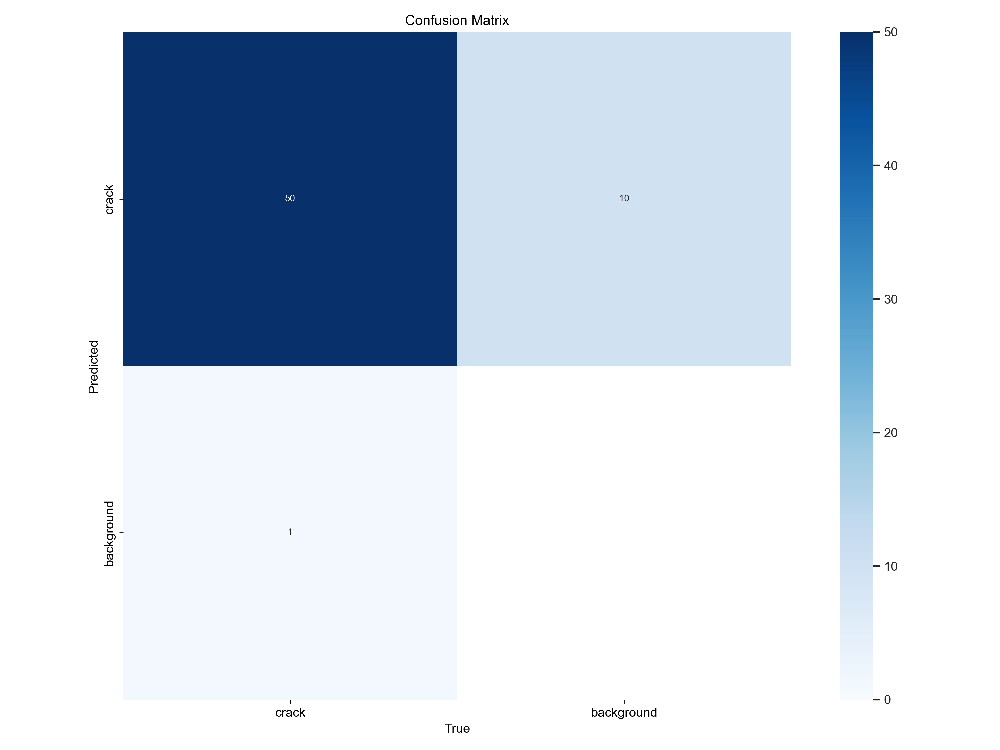

In [ ]:
from PIL import Image
from IPython.display import display

# Path to the confusion matrix image
image_path = r"C:\Users\Pauline\CVPA2\test_results\val13\confusion_matrix.png"

# Open the image
img = Image.open(image_path)

# Display the image in the notebook
display(img)

•	Copy all the images from ‘train_background’ folder to ‘train’ folder.

•	Retrain the model and validate the model with test set.


In [ ]:
import os
import shutil

# Source and destination directories
source_dir = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\raw\\train_background"
destination_dir = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\images\\train"

# Ensure the destination directory exists
os.makedirs(destination_dir, exist_ok=True)

# Transfer files
for filename in os.listdir(source_dir):
    source_path = os.path.join(source_dir, filename)
    destination_path = os.path.join(destination_dir, filename)

    # Check if it is a file before moving
    if os.path.isfile(source_path):
        shutil.move(source_path, destination_path)
        print(f"Moved: {source_path} -> {destination_path}")

print("File transfer completed.")


Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (1).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (1).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (10).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (10).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (11).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (11).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (12).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (12).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (13).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (13).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (14).jpg -> C:\Users\Pauline\CVPA2\datasets\crack400\images\train\bg (14).jpg
Moved: C:\Users\Pauline\CVPA2\datasets\crack400\raw\train_background\bg (15).jpg -> C:\Users\Pauline\C

In [ ]:
import os

# Path to the directory
directory_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\images\\train"

# Count the number of files in the directory
num_files = len([f for f in os.listdir(directory_path) if os.path.isfile(os.path.join(directory_path, f))])

print(f"Number of files in '{directory_path}': {num_files}")


Number of files in 'C:\Users\Pauline\CVPA2\datasets\crack400\images\train': 225


In [ ]:
import os
from ultralytics import YOLO

new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml_path, epochs=100, lr0=0.001, lrf=0.03, batch=16, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.44 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\datasets\crack400_updated.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\train_results, name=train14, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment

100%|██████████| 5.35M/5.35M [00:00<00:00, 34.1MB/s]


AMP: checks passed 


train: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\train.cache... 200 images, 25 backgrounds, 0 corrupt: 100%|██████████| 225/225 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\val.cache... 100 images, 15 backgrounds, 0 corrupt: 100%|██████████| 115/115 [00:00<?, ?it/s]


Plotting labels to C:\Users\Pauline\CVPA2\train_results\train14\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\train_results\train14
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.34G      1.604      2.878      1.799          2        640: 100%|██████████| 15/15 [00:05<00:00,  2.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.92it/s]

                   all        115        105    0.00296      0.971      0.255     0.0831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.37G      1.511      2.532      1.745          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.98it/s]

                   all        115        105    0.00296      0.971      0.272      0.114



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.38G      1.505      2.375      1.693          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.90it/s]

                   all        115        105      0.308      0.257      0.226     0.0812



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.38G      1.607      2.332      1.767          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.95it/s]

                   all        115        105      0.232      0.276      0.184     0.0552



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.38G      1.557      2.226      1.763          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.90it/s]

                   all        115        105      0.069      0.486     0.0736     0.0279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.38G      1.567       2.17      1.689          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.04it/s]

                   all        115        105     0.0764      0.181     0.0373     0.0108



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.37G      1.447      2.081      1.694          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  4.00it/s]

                   all        115        105       0.12      0.257     0.0922      0.031



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.38G      1.574      2.124      1.724          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.89it/s]

                   all        115        105     0.0255     0.0476    0.00773    0.00151



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.38G       1.51       1.99       1.64          6        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.96it/s]

                   all        115        105     0.0868      0.219       0.05     0.0122



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.38G        1.4      2.179      1.568          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.15it/s]

                   all        115        105      0.313      0.152      0.126     0.0544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.37G      1.321      2.114      1.481          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.00it/s]

                   all        115        105      0.181      0.333      0.141     0.0425



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.38G      1.546      1.905      1.664          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105     0.0734      0.381     0.0771     0.0287



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.38G      1.344      2.101      1.502          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.05it/s]

                   all        115        105      0.142       0.39      0.134     0.0435



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.38G      1.607      1.889      1.786          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.297      0.419      0.279      0.092



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.37G      1.468      1.669      1.616          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.262      0.381      0.206     0.0705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.38G      1.486      1.809      1.634          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.358      0.533      0.428      0.206



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.38G      1.499      1.774       1.68          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]

                   all        115        105        0.4      0.495      0.425      0.168



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.38G        1.5      1.821      1.593          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.89it/s]

                   all        115        105      0.502      0.676      0.548      0.236



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.37G      1.352      1.672      1.577          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.91it/s]

                   all        115        105      0.485      0.619        0.5      0.213



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.38G       1.56      1.755      1.773          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]

                   all        115        105      0.417      0.552      0.459      0.226



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.38G      1.452      1.685      1.644          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.308      0.362       0.27      0.116



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.38G      1.445      1.696      1.625          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.519        0.6      0.542      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.37G      1.425      1.618      1.638          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.04it/s]

                   all        115        105      0.341      0.405      0.348      0.149



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.38G      1.458      1.746      1.658          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]


                   all        115        105      0.396      0.514      0.404      0.174

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.38G      1.413       1.61      1.556          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all        115        105      0.552      0.704      0.646       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.38G      1.387      1.724      1.567          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.93it/s]

                   all        115        105      0.446      0.552      0.419      0.179



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.37G      1.323      1.535      1.514          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.533      0.505      0.533      0.231



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.38G      1.338      1.586      1.592          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.18it/s]

                   all        115        105      0.647      0.628      0.696      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.38G      1.433       1.56      1.624          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.669      0.657      0.683      0.338



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.38G      1.393      1.548      1.564          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.532       0.66      0.562      0.275



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.37G      1.229      1.427      1.479          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.607       0.59      0.583      0.285



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.38G      1.347       1.58      1.518          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.10it/s]

                   all        115        105      0.498      0.705       0.55      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.38G      1.278      1.467      1.484          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.19it/s]

                   all        115        105      0.701      0.669      0.702       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.38G      1.326       1.48      1.547          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.09it/s]

                   all        115        105      0.635      0.724      0.686      0.319



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.37G      1.241      1.404      1.447          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.04it/s]

                   all        115        105       0.59      0.714      0.604      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.38G      1.438      1.478      1.547          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.22it/s]

                   all        115        105       0.58      0.695      0.597      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.38G      1.275      1.413      1.447          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.10it/s]

                   all        115        105      0.688      0.771      0.727      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.38G      1.343      1.609      1.532          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.733      0.743      0.788       0.44



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.37G      1.245      1.298      1.441          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.783      0.762      0.821      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.38G       1.26       1.39      1.454          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.01it/s]

                   all        115        105      0.703      0.695      0.704      0.339



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.38G      1.265      1.435      1.492          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105       0.66      0.714      0.717      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.38G      1.283      1.459      1.508          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.719       0.79      0.757      0.411



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.37G      1.251      1.391      1.503          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]


                   all        115        105       0.76      0.722      0.749      0.403

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.38G      1.189       1.31      1.415          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105       0.72      0.838      0.798      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.38G      1.251      1.448      1.462          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.03it/s]

                   all        115        105      0.694      0.756      0.775      0.415



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.38G      1.227      1.288      1.451          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.10it/s]

                   all        115        105      0.645      0.733      0.708      0.421



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.37G      1.099      1.524      1.344          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105      0.601      0.714      0.694      0.367



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.38G      1.205       1.31      1.428          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.97it/s]

                   all        115        105       0.59       0.81      0.698      0.377



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.38G      1.195      1.306       1.44          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.12it/s]

                   all        115        105      0.692      0.771       0.74      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.38G      1.203      1.291      1.441          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.18it/s]

                   all        115        105      0.715      0.788       0.75       0.41



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.37G      1.146      1.339      1.457          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.752      0.781      0.789      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.38G      1.207      1.273      1.459          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]

                   all        115        105      0.735      0.771      0.763      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.38G      1.205       1.27      1.459          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.07it/s]


                   all        115        105      0.748      0.793      0.773       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.38G      1.191      1.294      1.456          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.12it/s]

                   all        115        105      0.751      0.717      0.784      0.407



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.37G      1.138      1.424      1.333          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.92it/s]

                   all        115        105      0.704      0.792       0.82       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.38G      1.221      1.329      1.442          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.14it/s]

                   all        115        105      0.792      0.819      0.823       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.38G      1.192      1.344       1.43          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.18it/s]

                   all        115        105      0.759      0.782      0.777      0.432



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.38G      1.215      1.274      1.414          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105      0.827      0.818      0.822       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.37G      1.123      1.251      1.419          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.22it/s]


                   all        115        105      0.736      0.819       0.78      0.419

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.38G      1.148      1.264      1.396          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.14it/s]

                   all        115        105      0.759      0.676      0.745      0.404



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.38G      1.156      1.241      1.395          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all        115        105      0.666      0.781      0.767      0.442



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.38G        1.1       1.25       1.35          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]


                   all        115        105      0.738      0.777      0.787      0.481

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.37G      1.191      1.201      1.388          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.807      0.839      0.842      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.38G      1.142       1.22      1.367          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.811      0.857      0.828      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.38G      1.172      1.295      1.428          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.827      0.829      0.822      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.38G      1.163      1.308      1.433          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105      0.788      0.852       0.83      0.503



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.37G      1.096      1.293      1.364          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.12it/s]


                   all        115        105      0.817      0.867      0.852       0.52

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.38G      1.098      1.246      1.363          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.15it/s]

                   all        115        105      0.769      0.838      0.823       0.47



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.38G      1.146       1.23      1.415          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]

                   all        115        105      0.775      0.819      0.821      0.502



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.37G      1.071      1.175      1.333          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.864      0.819      0.835      0.504



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.37G      1.122      1.198      1.372          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.06it/s]

                   all        115        105      0.851        0.8      0.826      0.501



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.38G      1.118      1.167      1.371          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all        115        105      0.835       0.82      0.847      0.508



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.38G      1.078      1.068      1.329          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.98it/s]

                   all        115        105      0.785      0.834      0.829       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.38G        1.1      1.173      1.383          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105      0.827      0.876      0.849      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.37G       1.12      1.187      1.394          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]


                   all        115        105      0.865      0.854      0.866       0.51

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.38G      1.087      1.157      1.355          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.15it/s]

                   all        115        105      0.812      0.867      0.845      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.37G       1.04      1.483      1.286          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.94it/s]


                   all        115        105      0.798      0.791      0.833      0.498

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.38G      1.101      1.118      1.427          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all        115        105      0.857        0.8      0.844      0.534



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.37G      1.098       1.15      1.401          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.16it/s]

                   all        115        105      0.819      0.848      0.844      0.521



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.38G      1.055      1.183      1.369          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.09it/s]


                   all        115        105      0.836      0.829      0.847        0.5

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.38G      1.024      1.091      1.325          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.08it/s]

                   all        115        105      0.878      0.819      0.862       0.48



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.38G      1.118      1.165      1.373          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.14it/s]

                   all        115        105      0.835      0.829      0.838      0.511



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.37G      1.006      1.068      1.313          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.891      0.838      0.859      0.532



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.38G      1.055      1.187      1.348          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.20it/s]

                   all        115        105      0.828      0.838      0.849       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.38G      1.029      1.072      1.339          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.89it/s]


                   all        115        105      0.803      0.867      0.837      0.515

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.38G      1.034      1.129      1.337          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]


                   all        115        105      0.803      0.857      0.829      0.501

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.37G      1.014      1.087      1.296          3        640: 100%|██████████| 15/15 [00:04<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.14it/s]

                   all        115        105      0.817       0.81      0.841      0.517



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.38G       1.08      1.395      1.399          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.10it/s]

                   all        115        105      0.847      0.841       0.85       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.38G      1.041        1.1      1.344          4        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.11it/s]


                   all        115        105      0.826      0.838      0.844      0.533

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.38G      1.155       1.29      1.415          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.09it/s]

                   all        115        105      0.787      0.838      0.826      0.524


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.37G       1.06       1.17      1.456          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.825      0.809      0.828      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.38G      1.287      1.286      1.666          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.13it/s]

                   all        115        105      0.814      0.834      0.829      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.37G      1.077      1.117      1.426          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.90it/s]

                   all        115        105      0.841      0.857      0.838      0.545



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.38G      1.086      1.037      1.435          2        640: 100%|██████████| 15/15 [00:04<00:00,  3.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.09it/s]

                   all        115        105      0.841      0.876      0.857      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.37G     0.9494      1.072      1.339          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.03it/s]


                   all        115        105      0.851       0.87      0.873      0.562

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.38G      1.068     0.9919       1.49          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.99it/s]

                   all        115        105      0.838      0.876      0.874      0.559



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.37G      1.043     0.9247      1.425          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.89it/s]

                   all        115        105       0.87      0.876      0.882       0.54



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.37G      0.944      1.015      1.375          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.885      0.895      0.896      0.551



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.37G     0.9772     0.9492      1.488          1        640: 100%|██████████| 15/15 [00:04<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.17it/s]

                   all        115        105      0.832      0.905      0.876       0.56



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.38G     0.8894      1.021      1.233          0        640: 100%|██████████| 15/15 [00:04<00:00,  3.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:00<00:00,  4.14it/s]

                   all        115        105      0.831      0.905       0.88      0.566



100 epochs completed in 0.173 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train14\weights\last.pt, 6.3MB
Optimizer stripped from C:\Users\Pauline\CVPA2\train_results\train14\weights\best.pt, 6.3MB

Validating C:\Users\Pauline\CVPA2\train_results\train14\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:01<00:00,  3.00it/s]


                   all        115        105      0.831      0.905      0.881      0.566
Speed: 1.3ms preprocess, 4.8ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\train_results\train14
Training results saved to: C:\Users\Pauline\CVPA2\train_results


In [ ]:
new_yaml_path = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400_updated.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train14\\weights\\best.pt')
results = model2.val(data=new_yaml_path, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\datasets\crack400\labels\test.cache... 50 images, 10 backgrounds, 0 corrupt: 100%|██████████| 60/60 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 4/4 [00:04<00:00,  1.16s/it]


                   all         60         51       0.94      0.941      0.979      0.662
Speed: 3.5ms preprocess, 8.3ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\test_results\val14
Test results have been saved to: C:\Users\Pauline\CVPA2\test_results


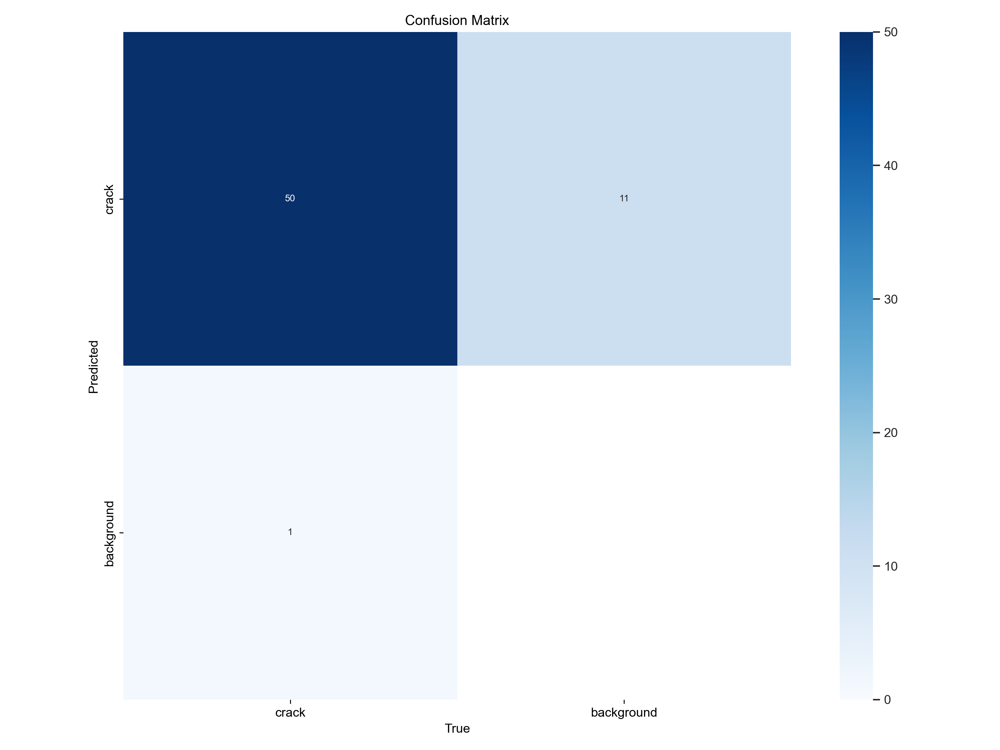

In [ ]:
from PIL import Image
from IPython.display import display

# Path to the confusion matrix image
image_path = r"C:\Users\Pauline\CVPA2\test_results\val14\confusion_matrix.png"

# Open the image
img = Image.open(image_path)

# Display the image in the notebook
display(img)

In [ ]:
# Test the model with test images:
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\train_results\\train14\\weights\\best.pt')
Test_Image = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\images\\test\\"
results = model2.predict(Test_Image,save=True)


image 1/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\072e3cf3-254.jpg: 640x640 2 cracks, 50.4ms
image 2/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\1336f6c6-165.jpg: 640x640 1 crack, 10.0ms
image 3/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\142592d2-134.jpg: 640x640 1 crack, 15.5ms
image 4/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\15222203-433.jpg: 640x640 1 crack, 4.3ms
image 5/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\19464eee-410.jpg: 640x640 1 crack, 0.0ms
image 6/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\32a8fbbe-265.jpg: 640x640 2 cracks, 8.8ms
image 7/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\39fa6705-46.jpg: 640x640 1 crack, 13.6ms
image 8/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\3d9e6b88-72.jpg: 640x640 1 crack, 16.8ms
image 9/60 C:\Users\Pauline\CVPA2\datasets\crack400\images\test\3ecc2527-45.jpg: 640x640 1 crack, 0.0ms
image 10/60 C:\Users\Pauline\CVPA2\datasets\crack4

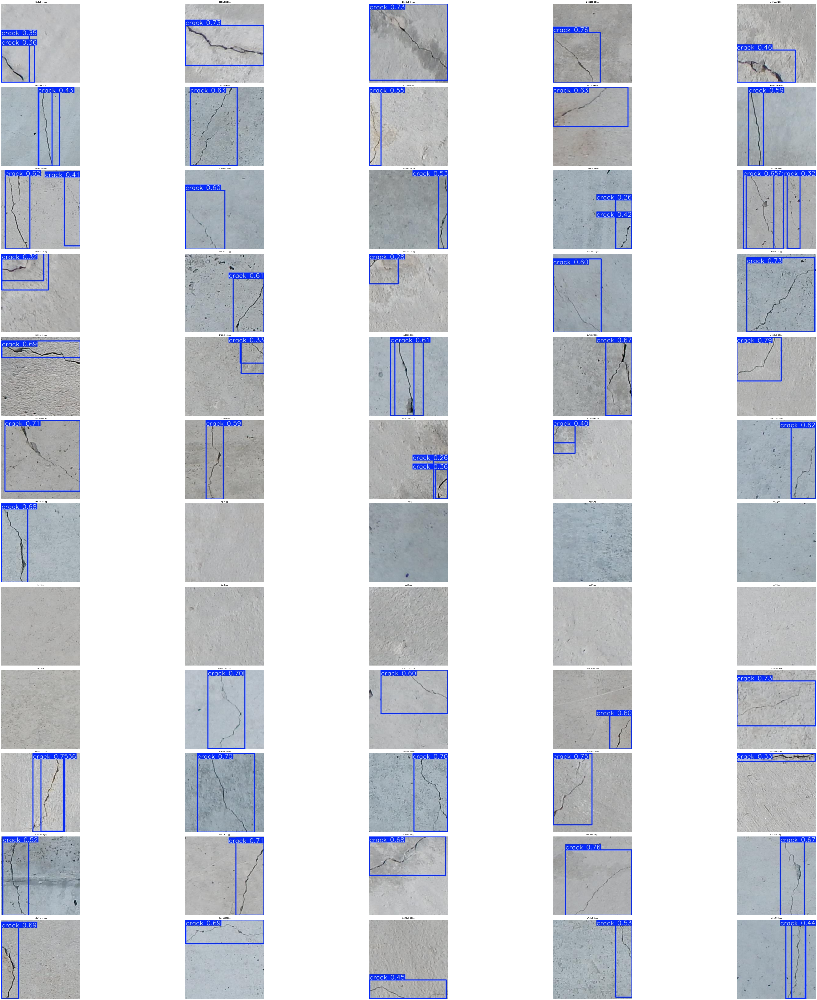

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt
%matplotlib inline

# Folder path where the images are stored
folder_path = "C:\\Users\\Pauline\\CVPA2\\runs\\detect\\predict3"

# List all image files in the folder
file_names = [file for file in os.listdir(folder_path) if file.endswith(('.png', '.jpg', '.jpeg'))]

# Display all images
plt.figure(figsize=(70, 70))  # Increase figure size to ensure all images fit
rows = len(file_names) // 5 + (1 if len(file_names) % 5 != 0 else 0)  # Calculate rows for 5 images per row
for idx, file_name in enumerate(file_names):
    image_path = os.path.join(folder_path, file_name)
    img = Image.open(image_path)  # Open image
    plt.subplot(rows, 5, idx + 1)
    plt.imshow(img)
    plt.axis('off')
    plt.title(file_name, fontsize=7)  # Reduce font size for better visibility

plt.tight_layout()
plt.show()


- Ground truth labels for manual visual comparison

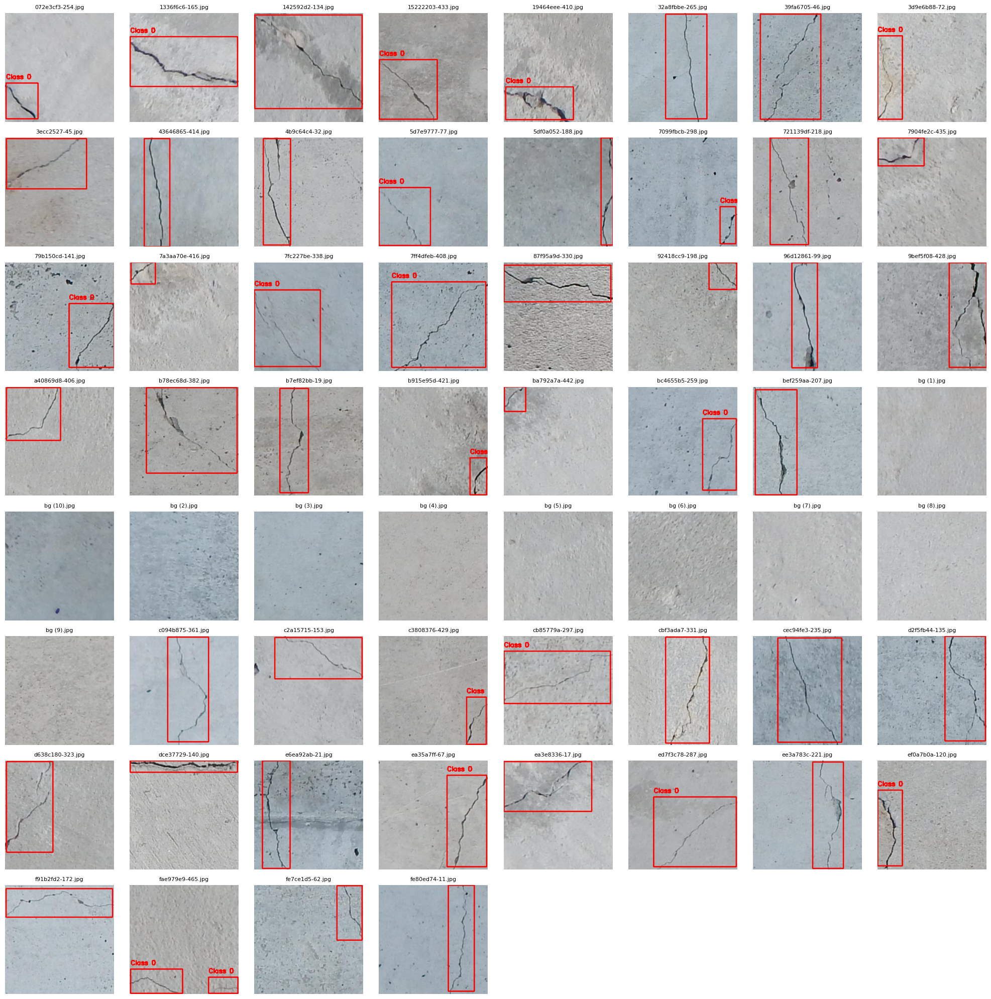

In [ ]:
#Compare with ground truth

import os
import cv2
import matplotlib.pyplot as plt

# Paths
image_folder = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\images\\test"
label_folder = "C:\\Users\\Pauline\\CVPA2\\datasets\\crack400\\labels\\test"

# Helper function to draw bounding boxes
def draw_bounding_boxes(image_path, label_path):
    # Read the image
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB for matplotlib

    # Read the label file
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f.readlines():
                # Parse YOLO format: class x_center y_center width height
                class_id, x_center, y_center, width, height = map(float, line.split())

                # Convert YOLO format to bounding box corners
                img_height, img_width, _ = image.shape
                x1 = int((x_center - width / 2) * img_width)
                y1 = int((y_center - height / 2) * img_height)
                x2 = int((x_center + width / 2) * img_width)
                y2 = int((y_center + height / 2) * img_height)

                # Draw the bounding box
                cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)  # Blue box for ground truth
                cv2.putText(image, f"Class {int(class_id)}", (x1, y1 - 10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    return image

# Display images with ground truth
plt.figure(figsize=(20, 20))
images = sorted(os.listdir(image_folder))  # Sort images for consistent order
for idx, image_name in enumerate(images):
    image_path = os.path.join(image_folder, image_name)
    label_path = os.path.join(label_folder, os.path.splitext(image_name)[0] + ".txt")

    if os.path.exists(image_path):
        # Draw bounding boxes on the image
        image_with_boxes = draw_bounding_boxes(image_path, label_path)

        # Plot the image
        plt.subplot(8, 8, idx + 1)  # Adjust rows/columns as needed
        plt.imshow(image_with_boxes)
        plt.axis('off')
        plt.title(image_name, fontsize=8)

plt.tight_layout()
plt.show()


### **[Task 2]** Write down experiment steps, settings, results and conclusions to the report. <br>
 * Adjust epochs with different values like 10, 20, 30, 50 and 100, retrain the model, study how epoch value impacts model performance (mAP50 and mAP50-95) on test set.
 * Adjust learning rate (lr0 and lrf) with different values like 0.01, 0.02, 0.03, 0.001, 0.002, 0.003, retrain the model, study how learning rate impacts model performance (mAP50 and mAP50-95) on test set.
 * Adjust batch with different size like 8, 16, 32, retrain the model, study how batch size impacts model performance (mAP50 and mAP50-95) on test set.
 * Check ‘confusion_matrix.png’ in ‘runs/detect/val/’, write down metrics (TP, FP, TN, FN) in confusion matrix.
 * Copy all the images from ‘train_background’ folder to ‘train’ folder.
 * Retrain the model and validate the model with test set.
 * Check ‘confusion_matrix.png’ in ‘runs/detect/val/’, study how the metrics (TP, FP, TN, FN) in confusion matrix are impacted after adding background images to training set.
 * Test the model through ‘model2.predict()’ command given above, find prediction results in ‘runs/detect/prediction#’ folder, and check whether the detection is accurate.


# 3. Retrain the model for live video detection, object tracking and counting

## 1) Create new dataset from the video

## 2) Similar to ‘crack400.yaml’, create a dataset config file ‘mydata.yaml’

## 3) Train a yolov8n.pt model with 'mydata' dataset

## 4)	Validate the model with the test set of ‘mydata’ dataset


In [ ]:
import os
from sklearn.model_selection import train_test_split
import shutil

# Paths
source = "C:\\Users\\Pauline\\CVPA2\\task3videoimages"
dest = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200\\raw"

# Get all .jpg files
files = [f for f in os.listdir(source) if f.endswith(".jpg")]

# Train-test-validation split
train_files, temp_files = train_test_split(files, test_size=0.3, random_state=42)
val_files, test_files = train_test_split(temp_files, test_size=0.5, random_state=42)

# Copy files to respective folders
for split, split_files in zip(["train", "val", "test"], [train_files, val_files, test_files]):
    os.makedirs(os.path.join(dest, "images", split), exist_ok=True)
    for f in split_files:
        shutil.copy(os.path.join(source, f), os.path.join(dest, "images", split, f))

print("Dataset split completed!")


Dataset split completed!


In [ ]:
import os

# Base directory
base_dir = r"C:\Users\Pauline\CVPA2\task3datasets\object200\raw\images"

# Subdirectories to check
subdirs = ['train', 'val', 'test']

# Count images in each folder
for subdir in subdirs:
    folder = os.path.join(base_dir, subdir)
    count = len([f for f in os.listdir(folder) if f.lower().endswith(('.jpg'))]) if os.path.exists(folder) else 0
    print(f"{subdir}: {count} images")


train: 160 images
val: 34 images
test: 35 images


In [ ]:
import os
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img, save_img

# Define the path to the train folder
train_folder = r"C:\Users\Pauline\CVPA2\task3datasets\object200\raw\images\train"

# Define the output folder for augmented images
augmented_folder = os.path.join(train_folder, "augmented")
os.makedirs(augmented_folder, exist_ok=True)

# Parameters for augmentation
datagen = ImageDataGenerator(
    rotation_range=30,        # Random rotation in degrees
    brightness_range=(0.5, 1.5),  # Adjust brightness
    width_shift_range=0.2,    # Horizontal shift
    height_shift_range=0.2,   # Vertical shift
    shear_range=0.2,          # Shearing
    zoom_range=0.2,           # Zoom
    horizontal_flip=True,     # Horizontal flip
    fill_mode='nearest'       # Filling strategy for empty pixels
)

# Get all images in the train folder
images = [f for f in os.listdir(train_folder) if f.lower().endswith(('.jpg'))]

# Counter to track the number of generated images
total_images = len(images)

# Generate new images until the total reaches 400
for image_name in images:
    if total_images >= 400:
        break

    img_path = os.path.join(train_folder, image_name)
    img = load_img(img_path)  # Load image
    x = img_to_array(img)     # Convert to array
    x = x.reshape((1,) + x.shape)  # Reshape for the generator

    # Generate augmented images
    i = 0
    for batch in datagen.flow(x, batch_size=1, save_to_dir=augmented_folder, save_prefix='aug', save_format='jpg'):
        i += 1
        total_images += 1
        if total_images >= 400:
            break

print(f"Augmented images generated in {augmented_folder}. Total images: {total_images}")


Augmented images generated in C:\Users\Pauline\CVPA2\task3datasets\object200\raw\images\train\augmented. Total images: 400


- Count the number of images in each folder before training

In [ ]:
import os

# Base directory
base_dir = r"C:\Users\Pauline\CVPA2\task3datasets\object200\images"

# Subdirectories to check
subdirs = ['train', 'val', 'test']

# Count images in each folder
for subdir in subdirs:
    folder = os.path.join(base_dir, subdir)
    count = len([f for f in os.listdir(folder) if f.lower().endswith(('.jpg'))]) if os.path.exists(folder) else 0
    print(f"{subdir}: {count} images")

train: 397 images
val: 34 images
test: 35 images


- Count number of labels per folder before training

In [ ]:
import os

# Base directory
base_dir = r"C:\Users\Pauline\CVPA2\task3datasets\object200\labels"

# Subdirectories to check
subdirs = ['train', 'val', 'test']

# Count images in each folder
for subdir in subdirs:
    folder = os.path.join(base_dir, subdir)
    count = len([f for f in os.listdir(folder) if f.lower().endswith(('.txt'))]) if os.path.exists(folder) else 0
    print(f"{subdir}: {count} labels")

train: 397 labels
val: 34 labels
test: 35 labels


- Check image size of images (H x W) in train, val and test folders

In [ ]:
import os
from PIL import Image

# Paths to folders
base_path = r"C:\Users\Pauline\CVPA2\task3datasets\object200\images"
folders = ["train", "val", "test"]

# Function to count files in each folder
def count_images_in_folder(folder_path):
    return len([f for f in os.listdir(folder_path) if os.path.isfile(os.path.join(folder_path, f))])

# Function to get image dimensions
def get_image_size(image_path):
    with Image.open(image_path) as img:
        return img.size  # Returns (width, height)

# Count and display the number of images in each folder and their sizes
for folder in folders:
    folder_path = os.path.join(base_path, folder)
    num_images = count_images_in_folder(folder_path)
    print(f"{folder}: {num_images} images")

    # Print image paths and dimensions
    for image_name in os.listdir(folder_path):
        image_path = os.path.join(folder_path, image_name)
        if os.path.isfile(image_path):  # Ensure it's a file
            try:
                width, height = get_image_size(image_path)
                print(f"Image: {image_name}, Size: {height}x{width}")
            except Exception as e:
                print(f"Error reading image {image_name}: {e}")

train: 397 images
Image: 012674d6-aug_0_6078.jpg, Size: 482x848
Image: 02a6f7bb-image05651.jpg, Size: 482x848
Image: 0368763a-aug_0_2493.jpg, Size: 482x848
Image: 04609ab2-aug_0_6176.jpg, Size: 482x848
Image: 04b70463-aug_0_8996.jpg, Size: 482x848
Image: 04de9371-aug_0_8815.jpg, Size: 482x848
Image: 04ea4994-aug_0_8888.jpg, Size: 482x848
Image: 05d8f74d-aug_0_7759.jpg, Size: 482x848
Image: 06b8223a-aug_0_9745.jpg, Size: 482x848
Image: 06d16e62-aug_0_2636.jpg, Size: 482x848
Image: 07d9c99f-aug_0_8374.jpg, Size: 482x848
Image: 07e15127-image03876.jpg, Size: 482x848
Image: 083222e4-image03201.jpg, Size: 482x848
Image: 08770e68-aug_0_7247.jpg, Size: 482x848
Image: 09cd10ee-aug_0_432.jpg, Size: 482x848
Image: 09ce1a7b-aug_0_3431.jpg, Size: 482x848
Image: 09d39731-aug_0_1129.jpg, Size: 482x848
Image: 0a2cf806-image01251.jpg, Size: 482x848
Image: 0cb2fae7-aug_0_1675.jpg, Size: 482x848
Image: 0dd80835-image00701.jpg, Size: 482x848
Image: 0dfa00d3-aug_0_8529.jpg, Size: 482x848
Image: 0e105823-a

- Start training using the base model parameters suggested in Task 1 (epochs=10, lr0=0.01, lrf=0.01, batch=8)

In [ ]:
import os
from ultralytics import YOLO

new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml, epochs=10, lr0=0.01, lrf=0.01, batch=8, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.44 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\task3datasets\object200.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\task3dataset\train_results, name=train, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, 

train: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\train... 397 images, 0 backgrounds, 0 corrupt: 100%|██████████| 397/397 [00:00<00:00, 1377.79it/s]

train: New cache created: C:\Users\Pauline\CVPA2\task3datasets\object200\labels\train.cache



val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\val... 34 images, 0 backgrounds, 0 corrupt: 100%|██████████| 34/34 [00:00<00:00, 1623.37it/s]

val: New cache created: C:\Users\Pauline\CVPA2\task3datasets\object200\labels\val.cache


Plotting labels to C:\Users\Pauline\CVPA2\task3dataset\train_results\train\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\task3dataset\train_results\train
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      1.12G      1.225      2.042      1.209         10        640: 100%|██████████| 50/50 [00:09<00:00,  5.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.13it/s]

                   all         34         66          1      0.425      0.884      0.566



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      1.17G      1.179      1.324      1.145          9        640: 100%|██████████| 50/50 [00:08<00:00,  5.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.23it/s]

                   all         34         66      0.943      0.784      0.894      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      1.17G      1.152      1.243       1.14         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.77it/s]

                   all         34         66      0.847      0.652      0.768      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      1.18G       1.13      1.138      1.113         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.67it/s]

                   all         34         66      0.855      0.909      0.872       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      1.18G      1.108      1.055      1.101         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.23it/s]

                   all         34         66      0.926      0.939      0.941      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      1.17G      1.074     0.9701      1.084         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.89it/s]

                   all         34         66      0.926      0.954      0.943      0.657



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      1.18G      1.071     0.9066        1.1         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.30it/s]

                   all         34         66      0.989      0.921      0.963       0.65



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      1.18G      1.028     0.8591      1.061         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.27it/s]

                   all         34         66      0.939      0.951      0.946      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      1.18G      1.011     0.8042      1.041         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00, 10.03it/s]

                   all         34         66      0.971      0.955      0.952      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      1.17G      1.002     0.7748      1.045         10        640: 100%|██████████| 50/50 [00:08<00:00,  5.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  9.96it/s]


                   all         34         66      0.993       0.97      0.965      0.692

10 epochs completed in 0.031 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\task3dataset\train_results\train\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  6.79it/s]


                   all         34         66      0.993       0.97      0.965      0.692
          elastic band         33         33      0.989      0.939      0.935      0.689
              eye drop         33         33      0.996          1      0.995      0.695
Speed: 0.6ms preprocess, 3.5ms inference, 0.0ms loss, 1.1ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\train_results\train
Training results saved to: C:\Users\Pauline\CVPA2\task3dataset\train_results


In [ ]:
import torch

# Path to the YOLO model
model_path = r'C:\Users\Pauline\CVPA2\task3dataset\train_results\train\weights\best.pt'

# Load the YOLO model
model = torch.load(model_path, map_location=torch.device('cpu'))

# Extract the number of classes
if 'nc' in model['model'].yaml:
    num_classes = model['model'].yaml['nc']
    print(f"Number of classes in the model: {num_classes}")
else:
    print("Could not find the number of classes in the model.")


Number of classes in the model: 2


In [ ]:
new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results\\train\\weights\\best.pt')
results = model2.val(data=new_yaml, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\test... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<00:00, 1169.74it/s]

val: New cache created: C:\Users\Pauline\CVPA2\task3datasets\object200\labels\test.cache



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.54s/it]


                   all         35         70      0.961      0.987      0.992      0.799
          elastic band         35         35      0.945      0.974       0.99      0.802
              eye drop         35         35      0.977          1      0.995      0.797
Speed: 1.9ms preprocess, 8.3ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\test_results\val
Test results have been saved to: C:\Users\Pauline\CVPA2\task3dataset\test_results


- Train with default yolov8n parameters

In [ ]:
import os
from ultralytics import YOLO

new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.44 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\task3datasets\object200.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\task3dataset\train_results, name=train2, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=Fals

train: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\train.cache... 397 images, 0 backgrounds, 0 corrupt: 100%|██████████| 397/397 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\val.cache... 34 images, 0 backgrounds, 0 corrupt: 100%|██████████| 34/34 [00:00<?, ?it/s]


Plotting labels to C:\Users\Pauline\CVPA2\task3dataset\train_results\train2\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\task3dataset\train_results\train2
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      2.35G      1.266      2.181      1.254         53        640: 100%|██████████| 25/25 [00:08<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.54it/s]

                   all         34         66      0.911      0.437       0.76       0.53



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      2.35G      1.211      1.217      1.193         52        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.60it/s]

                   all         34         66      0.937      0.741      0.879      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      2.34G      1.216      1.147      1.211         51        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.68it/s]

                   all         34         66      0.491      0.455      0.458      0.199



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      2.34G      1.188      1.047      1.177         44        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.48it/s]

                   all         34         66      0.913      0.288      0.418      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      2.34G      1.194      1.007      1.181         64        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.62it/s]

                   all         34         66      0.812      0.652      0.754      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      2.34G      1.166     0.9141      1.171         46        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.17it/s]

                   all         34         66      0.758      0.803      0.812      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      2.34G      1.152     0.8971      1.172         66        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.54it/s]

                   all         34         66      0.867      0.873      0.902      0.638



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      2.34G      1.148      0.858      1.167         61        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.32it/s]

                   all         34         66       0.84       0.94       0.95      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      2.34G      1.132     0.8087      1.159         49        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.80it/s]

                   all         34         66      0.922      0.751      0.896      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      2.34G      1.127     0.7959      1.167         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.62it/s]

                   all         34         66      0.802      0.673      0.795      0.529



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      2.34G      1.121     0.7513      1.161         61        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.54it/s]

                   all         34         66      0.913      0.966      0.972      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      2.34G      1.121     0.7371      1.164         46        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.60it/s]

                   all         34         66      0.863      0.848      0.885      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      2.34G       1.12     0.7305      1.174         57        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.51it/s]

                   all         34         66       0.97      0.959      0.974      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      2.34G      1.081     0.6888      1.163         66        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.83it/s]

                   all         34         66      0.895      0.955      0.947      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      2.34G      1.112     0.6723      1.175         36        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.83it/s]

                   all         34         66      0.888      0.939      0.971      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      2.34G      1.069     0.6702      1.146         37        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.71it/s]

                   all         34         66      0.955      0.969      0.974      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      2.34G        1.1     0.6552      1.159         52        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.25it/s]

                   all         34         66      0.951      0.939      0.989      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      2.34G       1.08     0.6601      1.154         63        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.978      0.953      0.984      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      2.34G      1.052     0.6249      1.151         56        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.969      0.937      0.977      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      2.34G      1.071     0.6234      1.149         49        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66       0.97       0.97      0.992      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      2.34G       1.05     0.6133      1.139         56        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.22it/s]

                   all         34         66      0.974      0.941       0.99      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      2.34G      1.044     0.6072      1.133         49        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.25it/s]

                   all         34         66      0.969      0.955      0.974      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      2.34G      1.067     0.6019      1.156         59        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.90it/s]

                   all         34         66      0.994      0.985      0.982      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      2.34G      1.045     0.5797      1.149         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.33it/s]

                   all         34         66      0.992       0.97      0.981      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      2.34G      1.015     0.5735      1.128         45        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.45it/s]

                   all         34         66      0.985      0.942      0.979      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      2.34G      1.033     0.5539      1.137         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66      0.978      0.955       0.97      0.683



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      2.34G      1.038     0.5727      1.133         54        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.68it/s]

                   all         34         66      0.995      0.934      0.977      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      2.34G      1.023     0.5699      1.122         66        640: 100%|██████████| 25/25 [00:08<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.96it/s]

                   all         34         66      0.941          1       0.99      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      2.34G      1.036     0.5691      1.133         59        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.943      0.985      0.989      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      2.34G      1.016     0.5556      1.143         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.29it/s]

                   all         34         66      0.968      0.961      0.977      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      2.34G      1.049      0.547      1.158         46        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66      0.983      0.919      0.976       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      2.34G      1.056     0.5508      1.147         49        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.37it/s]

                   all         34         66      0.961      0.955      0.972      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      2.34G     0.9886     0.5162      1.105         42        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.965       0.97       0.98      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      2.34G      1.001     0.5405      1.113         55        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66      0.951       0.97      0.973      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      2.34G      1.001     0.5329      1.118         41        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.25it/s]

                   all         34         66      0.987      0.958      0.978      0.684



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      2.34G      1.015      0.525      1.129         58        640: 100%|██████████| 25/25 [00:08<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.87it/s]

                   all         34         66      0.977       0.97      0.977      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      2.34G     0.9994      0.528      1.118         60        640: 100%|██████████| 25/25 [00:08<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.02it/s]

                   all         34         66      0.975      0.984       0.98      0.701



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      2.34G      1.011     0.5176      1.136         55        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.39it/s]

                   all         34         66      0.994      0.985      0.982      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      2.34G     0.9902     0.4983      1.103         51        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.99it/s]

                   all         34         66      0.998      0.979      0.981      0.677



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      2.34G      1.021     0.5288      1.148         48        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.02it/s]

                   all         34         66       0.99      0.959      0.982       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      2.34G     0.9845     0.5016      1.102         62        640: 100%|██████████| 25/25 [00:08<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.90it/s]

                   all         34         66      0.955      0.939      0.976      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      2.34G     0.9932     0.5032       1.11         57        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.09it/s]

                   all         34         66      0.975      0.973      0.982      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      2.34G     0.9652     0.5005       1.12         52        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.51it/s]

                   all         34         66      0.996      0.976      0.982      0.679



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      2.34G     0.9904     0.5129      1.115         54        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.80it/s]

                   all         34         66      0.986      0.922      0.979      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      2.34G     0.9759     0.4873      1.114         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.96it/s]

                   all         34         66      0.997       0.97       0.98      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      2.34G      0.964     0.4848      1.111         51        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.90it/s]

                   all         34         66          1      0.976      0.982      0.712



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      2.34G      0.977     0.4832      1.117         56        640: 100%|██████████| 25/25 [00:08<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.96it/s]

                   all         34         66      0.972          1      0.994      0.668



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      2.34G     0.9549       0.48      1.108         60        640: 100%|██████████| 25/25 [00:08<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.02it/s]

                   all         34         66      0.989      0.967       0.99      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      2.34G     0.9482     0.4739      1.104         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66       0.98      0.953      0.986      0.694



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      2.34G     0.9545     0.4733        1.1         53        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.09it/s]

                   all         34         66      0.968      0.967       0.99       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      2.34G     0.9657     0.4861      1.107         53        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66       0.98      0.968      0.983        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      2.34G     0.9641     0.4875      1.108         58        640: 100%|██████████| 25/25 [00:08<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.60it/s]

                   all         34         66      0.961       0.97      0.992      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      2.34G     0.9306     0.4605      1.105         45        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.86it/s]

                   all         34         66      0.989       0.97      0.982      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      2.34G     0.9504     0.4727      1.108         55        640: 100%|██████████| 25/25 [00:08<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.19it/s]

                   all         34         66      0.995       0.98      0.982      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      2.34G     0.9529     0.4763      1.097         48        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66      0.955      0.984      0.992      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      2.34G     0.9298     0.4667      1.081         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.39it/s]

                   all         34         66       0.96      0.968      0.977      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      2.34G     0.9481     0.4631      1.104         57        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.80it/s]

                   all         34         66      0.996      0.964      0.982       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      2.34G     0.9261     0.4615      1.089         46        640: 100%|██████████| 25/25 [00:08<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.91it/s]

                   all         34         66      0.971      0.959      0.976      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      2.34G     0.9497     0.4681        1.1         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.90it/s]

                   all         34         66      0.986      0.985      0.982      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      2.34G     0.9328      0.457      1.099         45        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.05it/s]

                   all         34         66      0.981      0.972      0.981      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      2.34G     0.8955     0.4379      1.071         55        640: 100%|██████████| 25/25 [00:09<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  5.05it/s]

                   all         34         66      0.968       0.97      0.981       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      2.34G     0.9217     0.4467      1.072         59        640: 100%|██████████| 25/25 [00:08<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66      0.995       0.97      0.983      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      2.34G     0.9229     0.4367      1.096         60        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.12it/s]

                   all         34         66      0.995      0.961      0.981      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      2.34G      0.914      0.442      1.092         47        640: 100%|██████████| 25/25 [00:08<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  4.07it/s]

                   all         34         66      0.997      0.948      0.978       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      2.34G     0.9069     0.4464      1.085         52        640: 100%|██████████| 25/25 [00:09<00:00,  2.75it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.98it/s]

                   all         34         66      0.985       0.97      0.981      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      2.34G     0.9144     0.4348      1.078         52        640: 100%|██████████| 25/25 [00:08<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.38it/s]

                   all         34         66      0.998      0.969      0.982      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      2.34G     0.9048     0.4365      1.083         61        640: 100%|██████████| 25/25 [00:08<00:00,  2.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.40it/s]

                   all         34         66      0.986       0.97      0.986      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      2.34G     0.8995     0.4272      1.072         64        640: 100%|██████████| 25/25 [00:08<00:00,  3.00it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.45it/s]

                   all         34         66      0.988       0.97      0.979        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      2.34G       0.91     0.4314      1.072         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.993      0.985      0.986       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      2.34G     0.8997      0.431       1.08         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.74it/s]

                   all         34         66       0.99      0.982      0.982      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      2.34G     0.8765     0.4149       1.07         70        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.36it/s]

                   all         34         66      0.991      0.982      0.981      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      2.34G     0.8815     0.4229      1.063         56        640: 100%|██████████| 25/25 [00:08<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.71it/s]

                   all         34         66      0.971      0.978      0.982      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      2.34G     0.9207     0.4352      1.082         63        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.99it/s]

                   all         34         66      0.993       0.97      0.982      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      2.34G     0.8905     0.4276      1.081         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66      0.993      0.968      0.987      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      2.34G     0.8718     0.4047      1.054         52        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.62it/s]

                   all         34         66      0.995      0.965      0.987      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      2.34G     0.8836     0.4217      1.079         39        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.32it/s]

                   all         34         66      0.995      0.969      0.981      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      2.34G     0.8705     0.4116      1.075         46        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.05it/s]

                   all         34         66      0.997       0.97      0.988      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      2.34G     0.8545     0.4061      1.063         42        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.46it/s]

                   all         34         66      0.998      0.969      0.981      0.641



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      2.34G     0.8746     0.4249      1.067         59        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66      0.998      0.967       0.98      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      2.34G     0.8652     0.4066      1.065         48        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.22it/s]

                   all         34         66      0.992      0.968      0.978       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      2.34G     0.8894     0.4208      1.077         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.09it/s]

                   all         34         66      0.982       0.97       0.98      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      2.34G     0.8512     0.4006      1.056         47        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.74it/s]

                   all         34         66      0.997       0.97      0.982      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      2.34G       0.85     0.4046      1.071         58        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.99it/s]

                   all         34         66      0.983       0.97      0.981      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      2.34G      0.834     0.4001      1.051         63        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.93it/s]

                   all         34         66      0.984      0.969       0.98       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      2.34G     0.8418     0.3946      1.065         54        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.60it/s]

                   all         34         66      0.997       0.97      0.983      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      2.34G     0.8572     0.3938      1.069         59        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66      0.992      0.967      0.983      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      2.34G     0.8261     0.3847       1.04         55        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.99it/s]

                   all         34         66      0.993      0.961      0.983      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      2.34G     0.8224     0.3789      1.035         50        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.22it/s]

                   all         34         66      0.994      0.964      0.984      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      2.34G     0.8362     0.3877      1.058         58        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.02it/s]

                   all         34         66      0.996      0.967      0.989      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      2.34G     0.8274     0.3865      1.044         43        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.05it/s]

                   all         34         66      0.982       0.97      0.981      0.698


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      2.34G     0.7947     0.3476      1.035         26        640: 100%|██████████| 25/25 [00:08<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.29it/s]

                   all         34         66      0.996       0.97      0.982      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      2.34G     0.7819     0.3341      1.028         25        640: 100%|██████████| 25/25 [00:08<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.60it/s]

                   all         34         66      0.997       0.97      0.983      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      2.34G     0.7772     0.3323      1.017         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.25it/s]

                   all         34         66       0.99      0.983      0.984      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      2.34G     0.7711     0.3241      1.012         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.15it/s]

                   all         34         66      0.989      0.983      0.984      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      2.34G     0.7556     0.3217      1.025         25        640: 100%|██████████| 25/25 [00:08<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.96it/s]

                   all         34         66      0.987      0.982      0.984      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      2.34G     0.7591     0.3196      1.022         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.09it/s]

                   all         34         66       0.99      0.983      0.984      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      2.34G     0.7504     0.3154          1         25        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.57it/s]

                   all         34         66      0.991      0.983      0.984      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      2.34G     0.7536     0.3168      1.023         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.99it/s]

                   all         34         66      0.991      0.982      0.986      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      2.34G     0.7394     0.3098      1.004         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  7.57it/s]

                   all         34         66      0.991      0.983      0.984      0.722



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      2.34G     0.7545     0.3128      1.014         26        640: 100%|██████████| 25/25 [00:08<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  8.25it/s]

                   all         34         66      0.998       0.97      0.983      0.719



100 epochs completed in 0.251 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train2\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train2\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\task3dataset\train_results\train2\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  6.47it/s]


                   all         34         66      0.993      0.985      0.986      0.742
          elastic band         33         33          1      0.969      0.978      0.731
              eye drop         33         33      0.986          1      0.995      0.753
Speed: 0.7ms preprocess, 3.0ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\train_results\train2
Training results saved to: C:\Users\Pauline\CVPA2\task3dataset\train_results


In [ ]:
new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results\\train2\\weights\\best.pt')
results = model2.val(data=new_yaml, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\test.cache... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.61s/it]


                   all         35         70      0.983          1      0.994      0.805
          elastic band         35         35      0.971          1      0.994      0.808
              eye drop         35         35      0.995          1      0.995      0.802
Speed: 2.2ms preprocess, 6.6ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\test_results\val2
Test results have been saved to: C:\Users\Pauline\CVPA2\task3dataset\test_results


- Train with epochs=100, lr0=0.01, lrf=0.01, batch=32

In [ ]:
import os
from ultralytics import YOLO

new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results'
os.makedirs(destination_dir, exist_ok=True)

# Load a pretrained YOLO model
model1 = YOLO('C:\\Users\\Pauline\\CVPA2\\yolov8n.pt')

# Retrain the model
results = model1.train(data=new_yaml, epochs=100, lr0=0.01, lrf=0.01, batch=32, project=destination_dir, device=0, pretrained=False)

print(f"Training results saved to: {destination_dir}")

New https://pypi.org/project/ultralytics/8.3.44 available  Update with 'pip install -U ultralytics'
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
engine\trainer: task=detect, mode=train, model=C:\Users\Pauline\CVPA2\yolov8n.pt, data=C:\Users\Pauline\CVPA2\task3datasets\object200.yaml, epochs=100, time=None, patience=100, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=C:\Users\Pauline\CVPA2\task3dataset\train_results, name=train3, exist_ok=False, pretrained=False, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=Fals

train: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\train.cache... 397 images, 0 backgrounds, 0 corrupt: 100%|██████████| 397/397 [00:00<?, ?it/s]
val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\val.cache... 34 images, 0 backgrounds, 0 corrupt: 100%|██████████| 34/34 [00:00<?, ?it/s]


Plotting labels to C:\Users\Pauline\CVPA2\task3dataset\train_results\train3\labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to C:\Users\Pauline\CVPA2\task3dataset\train_results\train3
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      4.15G      1.371      2.852      1.328         56        640: 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all         34         66    0.00648          1      0.663      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.09G      1.176      1.276      1.158         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.86it/s]

                   all         34         66          1      0.251      0.887      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.07G      1.144      1.073       1.14         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.80it/s]

                   all         34         66      0.979      0.459      0.873      0.595



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.07G      1.166      1.059      1.172         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]

                   all         34         66      0.889      0.545      0.875      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      4.07G       1.17     0.9959      1.156         62        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.77it/s]

                   all         34         66      0.872      0.864      0.939       0.67



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100       4.1G      1.141     0.9359      1.158         40        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         34         66      0.863      0.722      0.841       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.07G      1.123      0.909      1.141         66        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.49it/s]

                   all         34         66      0.681      0.627      0.699      0.459



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100       4.1G      1.145      0.887      1.149         63        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all         34         66      0.763       0.68       0.78      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.07G      1.158     0.8573      1.144         47        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.40it/s]

                   all         34         66       0.87      0.603      0.752      0.516



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100       4.1G      1.168     0.8223      1.178         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all         34         66      0.722      0.712      0.756      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.07G      1.108     0.7734      1.142         64        640: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all         34         66      0.508      0.475      0.524      0.344



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       4.1G      1.122     0.7686      1.148         45        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all         34         66      0.774      0.712      0.796      0.463



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.07G      1.129     0.7345      1.135         63        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.968      0.896      0.944      0.656



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       4.1G      1.101     0.7157      1.139         69        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.11it/s]

                   all         34         66      0.888      0.917       0.93       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.07G      1.106     0.7115      1.147         38        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         34         66      0.897      0.909      0.955        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       4.1G      1.108     0.6885      1.154         39        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all         34         66      0.963      0.852      0.931      0.653



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.07G      1.092     0.6769      1.142         48        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.843        0.8      0.888      0.614



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       4.1G       1.09     0.6512      1.128         68        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.811      0.894      0.875      0.648



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.07G      1.096     0.6618      1.153         56        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all         34         66      0.917      0.853      0.915      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100       4.1G       1.08     0.6358      1.125         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.06it/s]

                   all         34         66      0.869      0.851      0.929      0.628



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.07G      1.059     0.6186      1.111         59        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]

                   all         34         66      0.935      0.932       0.98      0.672



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100       4.1G      1.066     0.6057       1.13         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]

                   all         34         66      0.955      0.967      0.983      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.07G      1.066     0.6267      1.133         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.933      0.924      0.978      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100       4.1G      1.048     0.6011       1.14         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]

                   all         34         66      0.943      0.909      0.964      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.07G      1.022     0.5684      1.118         48        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.20it/s]

                   all         34         66      0.972      0.924      0.975      0.716



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100       4.1G      1.043     0.5808      1.139         45        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]

                   all         34         66      0.951      0.937      0.964      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.07G      1.056     0.5929      1.123         54        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.968      0.909      0.969      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100       4.1G      1.024     0.5838       1.11         67        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.912      0.955      0.947      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.07G      1.035     0.5686      1.129         58        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]

                   all         34         66      0.884      0.923      0.937      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100       4.1G       1.02     0.5609      1.121         43        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.73it/s]

                   all         34         66      0.961      0.928      0.967      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.07G      1.011     0.5583      1.109         44        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         34         66      0.929       0.98      0.987      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       4.1G      1.017     0.5445      1.122         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all         34         66      0.959      0.909      0.951      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.07G      1.035     0.5565      1.123         44        640: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.98it/s]

                   all         34         66       0.96      0.925      0.965      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100       4.1G      1.029     0.5466      1.125         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         34         66      0.963      0.962       0.99      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.07G     0.9834     0.5353      1.096         46        640: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.87it/s]

                   all         34         66      0.951      0.918      0.959      0.624



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100       4.1G      1.024     0.5536      1.115         54        640: 100%|██████████| 13/13 [00:07<00:00,  1.66it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66      0.955       0.97      0.974      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.07G      1.028     0.5479       1.12         58        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]

                   all         34         66      0.921      0.912      0.942      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100       4.1G     0.9947     0.5299      1.112         57        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]

                   all         34         66      0.985      0.985      0.987      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.07G     0.9928     0.5245      1.103         48        640: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66      0.933      0.985      0.987      0.664



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100       4.1G      1.001     0.5181      1.115         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66      0.983      0.976      0.995      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.07G     0.9939     0.5078      1.095         62        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.16it/s]

                   all         34         66      0.964       0.97      0.989      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100       4.1G     0.9836     0.5078      1.105         61        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66      0.987      0.997      0.995      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.07G     0.9818     0.5187      1.105         47        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]

                   all         34         66      0.923      0.978      0.982      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       4.1G     0.9812     0.5044      1.087         54        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.67it/s]

                   all         34         66      0.991       0.97      0.994      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.07G     0.9884     0.5197      1.106         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all         34         66      0.908      0.998      0.983      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100       4.1G      0.967     0.4936      1.096         56        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         34         66      0.986      0.962      0.993      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.07G     0.9561     0.4937      1.078         53        640: 100%|██████████| 13/13 [00:08<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.62it/s]

                   all         34         66      0.997      0.968      0.993      0.743



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100       4.1G     0.9733     0.4837      1.088         60        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all         34         66      0.998       0.97      0.992      0.718



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.07G     0.9622     0.4756      1.085         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.70it/s]

                   all         34         66      0.988      0.983      0.993      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       4.1G     0.9645     0.4879      1.087         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66      0.977      0.982      0.981      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.07G     0.9565     0.4881      1.088         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.31it/s]

                   all         34         66      0.991       0.97      0.994      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100       4.1G     0.9578      0.477      1.085         61        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.34it/s]

                   all         34         66      0.965      0.958      0.965      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.07G     0.9763     0.4853      1.089         47        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.34it/s]

                   all         34         66      0.983      0.972      0.986       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100       4.1G     0.9549     0.4843      1.076         57        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.08it/s]

                   all         34         66       0.98      0.955      0.968       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.07G      0.945     0.4826      1.072         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all         34         66      0.978      0.968      0.967      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100       4.1G      0.932     0.4626      1.068         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.953      0.996      0.993      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.07G     0.9356     0.4689      1.076         55        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.992       0.97      0.993      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       4.1G     0.9393     0.4597       1.07         44        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.51it/s]

                   all         34         66      0.994       0.97      0.982      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.07G     0.9344     0.4633      1.074         47        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66      0.994       0.97      0.978      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100       4.1G     0.9488     0.4655      1.087         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         34         66      0.983      0.968      0.967      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.07G     0.9243     0.4497      1.077         60        640: 100%|██████████| 13/13 [00:07<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all         34         66      0.944      0.968      0.966      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100       4.1G     0.9105     0.4494      1.056         62        640: 100%|██████████| 13/13 [00:07<00:00,  1.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]

                   all         34         66      0.983      0.966      0.975      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.07G     0.9345     0.4564      1.089         65        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66       0.98      0.982      0.976      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100       4.1G     0.9301     0.4448      1.086         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.982          1      0.995      0.721



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.07G     0.9003     0.4402      1.065         47        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         34         66      0.982      0.983      0.991      0.725



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100       4.1G     0.8971      0.435       1.06         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.70it/s]

                   all         34         66          1      0.976      0.995      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.07G     0.8968     0.4459      1.057         59        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66      0.987          1      0.995      0.705



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100       4.1G     0.9084     0.4329       1.06         66        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.96it/s]

                   all         34         66      0.997      0.968      0.982      0.706



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.07G     0.9216     0.4538       1.08         55        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all         34         66      0.996      0.982      0.988      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100       4.1G     0.9014     0.4353      1.066         51        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.90it/s]

                   all         34         66      0.996      0.973      0.984      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.07G     0.8907     0.4264      1.057         67        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.987      0.991      0.995       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100       4.1G     0.8748     0.4324      1.054         57        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.36it/s]

                   all         34         66      0.992      0.972      0.995      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.07G     0.8723     0.4167      1.042         59        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         34         66      0.985      0.971      0.995      0.681



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100       4.1G     0.8945     0.4283      1.059         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.40it/s]

                   all         34         66       0.98       0.98      0.993      0.693



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.07G     0.8736     0.4155      1.037         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.23it/s]

                   all         34         66      0.979      0.998      0.995      0.687



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100       4.1G      0.873     0.4219      1.061         38        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.18it/s]

                   all         34         66      0.997      0.975      0.995      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.07G     0.8643     0.4232       1.06         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.997      0.967      0.993      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100       4.1G     0.8487     0.4078      1.037         46        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.99it/s]

                   all         34         66       0.99      0.998      0.995      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.07G     0.8534     0.4135      1.044         54        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.89it/s]

                   all         34         66       0.99      0.985      0.995      0.666



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100       4.1G     0.8662     0.4134      1.059         52        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66       0.99      0.998      0.995      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.07G     0.8409     0.4083      1.043         46        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66      0.982      0.962       0.98      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100       4.1G     0.8406        0.4      1.029         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66       0.99      0.998      0.995      0.719



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      4.07G     0.8368     0.3986      1.042         61        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.34it/s]

                   all         34         66      0.995      0.982      0.994      0.685



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100       4.1G     0.8217     0.4023      1.025         59        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.04it/s]

                   all         34         66      0.987      0.984      0.995      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.07G     0.8089     0.3892      1.039         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.28it/s]

                   all         34         66      0.991          1      0.995      0.758



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100       4.1G     0.8342      0.397      1.038         57        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.03it/s]

                   all         34         66      0.959      0.985       0.99      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.07G     0.8134     0.3996      1.022         49        640: 100%|██████████| 13/13 [00:07<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.25it/s]

                   all         34         66      0.981          1      0.995      0.714



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100       4.1G     0.8068     0.3849      1.015         53        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.84it/s]

                   all         34         66      0.983      0.995      0.994      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.07G     0.8303      0.394      1.036         60        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         34         66      0.966      0.981      0.982      0.697



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       4.1G     0.8024      0.386      1.025         50        640: 100%|██████████| 13/13 [00:07<00:00,  1.69it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.14it/s]

                   all         34         66      0.964      0.985      0.982      0.722


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.07G     0.7972     0.3591      1.013         26        640: 100%|██████████| 13/13 [00:08<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.47it/s]

                   all         34         66      0.981          1      0.995      0.667



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       4.1G     0.7816     0.3362      1.012         25        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.38it/s]

                   all         34         66      0.978      0.999      0.995      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.07G     0.7639     0.3248     0.9945         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.32it/s]

                   all         34         66       0.98      0.999      0.995      0.702



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       4.1G     0.7521     0.3212      0.994         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.48it/s]

                   all         34         66      0.978      0.998      0.995      0.673



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.07G     0.7471     0.3223     0.9861         25        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all         34         66      0.995      0.981      0.995      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100       4.1G     0.7413     0.3186     0.9956         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.21it/s]

                   all         34         66      0.982          1      0.995      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.07G     0.7398     0.3143     0.9863         25        640: 100%|██████████| 13/13 [00:07<00:00,  1.72it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.92it/s]

                   all         34         66      0.981      0.998      0.995      0.696



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100       4.1G     0.7407     0.3141     0.9992         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.30it/s]

                   all         34         66      0.993      0.999      0.995      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.07G     0.7287     0.3086     0.9836         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.73it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.87it/s]

                   all         34         66      0.993      0.999      0.995       0.69



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100       4.1G     0.7277     0.3065     0.9785         26        640: 100%|██████████| 13/13 [00:07<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.40it/s]

                   all         34         66      0.984      0.999      0.995      0.687



100 epochs completed in 0.237 hours.
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train3\weights\last.pt, 6.2MB
Optimizer stripped from C:\Users\Pauline\CVPA2\task3dataset\train_results\train3\weights\best.pt, 6.2MB

Validating C:\Users\Pauline\CVPA2\task3dataset\train_results\train3\weights\best.pt...
Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.53it/s]


                   all         34         66      0.987      0.991      0.995      0.754
          elastic band         33         33          1      0.981      0.995      0.727
              eye drop         33         33      0.973          1      0.995      0.781
Speed: 0.2ms preprocess, 3.1ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\train_results\train3
Training results saved to: C:\Users\Pauline\CVPA2\task3dataset\train_results


In [ ]:
new_yaml = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200.yaml"

# Ensure the destination directory exists
destination_dir = 'C:\\Users\\Pauline\\CVPA2\\task3dataset\\test_results'
os.makedirs(destination_dir, exist_ok=True)

# Evaluate new model's performance on the test set
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results\\train3\\weights\\best.pt')
results = model2.val(data=new_yaml, split='test', project=destination_dir)

print(f"Test results have been saved to: {destination_dir}")

Ultralytics 8.3.43  Python-3.8.20 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce GTX 1060 6GB, 6144MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning C:\Users\Pauline\CVPA2\task3datasets\object200\labels\test.cache... 35 images, 0 backgrounds, 0 corrupt: 100%|██████████| 35/35 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:04<00:00,  1.58s/it]


                   all         35         70      0.978      0.971      0.986      0.804
          elastic band         35         35      0.996      0.971      0.994      0.809
              eye drop         35         35       0.96      0.971      0.978      0.799
Speed: 2.1ms preprocess, 9.6ms inference, 0.0ms loss, 3.8ms postprocess per image
Results saved to C:\Users\Pauline\CVPA2\task3dataset\test_results\val3
Test results have been saved to: C:\Users\Pauline\CVPA2\task3dataset\test_results


- Confusion matrix for the best model

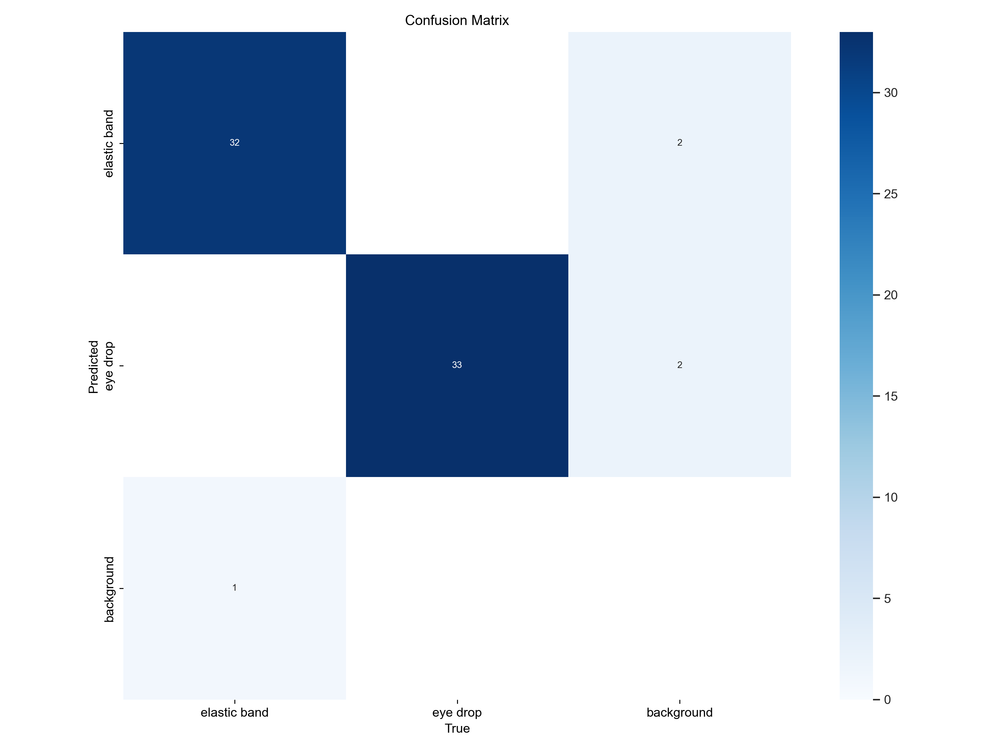

In [ ]:
from PIL import Image
from IPython.display import display

# Path to the confusion matrix image
image_path = "C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results\\train2\\confusion_matrix.png"

# Open the image
img = Image.open(image_path)

# Display the image in the notebook
display(img)


- Print the test images with predicted bounding boxes

In [ ]:
from ultralytics import YOLO

# Load the trained YOLO model
model2 = YOLO('C:\\Users\\Pauline\\CVPA2\\task3dataset\\train_results\\train2\\weights\\best.pt')

# Path to the test images
Test_Image = "C:\\Users\\Pauline\\CVPA2\\task3datasets\\object200\\images\\test\\"

# Perform predictions on the test images
results = model2.predict(Test_Image, save=True)



image 1/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\071268bc-image01376.jpg: 384x640 1 elastic band, 1 eye drop, 18.0ms
image 2/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\1dc94974-image02826.jpg: 384x640 1 elastic band, 1 eye drop, 9.0ms
image 3/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\200d1a4a-image01876.jpg: 384x640 1 elastic band, 1 eye drop, 10.0ms
image 4/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\21069208-image00451.jpg: 384x640 1 elastic band, 1 eye drop, 9.9ms
image 5/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\236d76c3-image02601.jpg: 384x640 2 elastic bands, 1 eye drop, 10.0ms
image 6/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\240b299e-image05326.jpg: 384x640 1 elastic band, 2 eye drops, 10.0ms
image 7/35 C:\Users\Pauline\CVPA2\task3datasets\object200\images\test\2b4204c2-image02326.jpg: 384x640 1 elastic band, 1 eye drop, 11.0ms
image 8/35 C:\Users\Pauline\CVPA2